# Insurance Claims - Fraud Detection Project

### Problem Statement:

Insurance fraud is a huge problem in the industry. It's difficult to identify fraud claims. Machine Learning is in a unique position to help the Auto Insurance industry with this problem.

In this project, you are provided a dataset which has the details of the insurance policy along with the customer details. It also has the details of the accident on the basis of which the claims have been made. 

In this example, you will be working with some auto insurance data to demonstrate how you can create a predictive model that predicts if an insurance claim is fraudulent or not. 

In [1]:
# Importing Required Libraries
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor

import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

### Importing DataSet

In [2]:
data = pd.read_csv("Automobile_insurance_fraud.csv")
data

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported,_c39
0,328,48,521585,17-10-2014,OH,250/500,1000,1406.91,0,466132,...,YES,71610,6510,13020,52080,Saab,92x,2004,Y,NaN
1,228,42,342868,27-06-2006,IN,250/500,2000,1197.22,5000000,468176,...,?,5070,780,780,3510,Mercedes,E400,2007,Y,NaN
2,134,29,687698,06-09-2000,OH,100/300,2000,1413.14,5000000,430632,...,NO,34650,7700,3850,23100,Dodge,RAM,2007,N,NaN
3,256,41,227811,25-05-1990,IL,250/500,2000,1415.74,6000000,608117,...,NO,63400,6340,6340,50720,Chevrolet,Tahoe,2014,Y,NaN
4,228,44,367455,06-06-2014,IL,500/1000,1000,1583.91,6000000,610706,...,NO,6500,1300,650,4550,Accura,RSX,2009,N,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,3,38,941851,16-07-1991,OH,500/1000,1000,1310.80,0,431289,...,?,87200,17440,8720,61040,Honda,Accord,2006,N,NaN
996,285,41,186934,05-01-2014,IL,100/300,1000,1436.79,0,608177,...,?,108480,18080,18080,72320,Volkswagen,Passat,2015,N,NaN
997,130,34,918516,17-02-2003,OH,250/500,500,1383.49,3000000,442797,...,YES,67500,7500,7500,52500,Suburu,Impreza,1996,N,NaN
998,458,62,533940,18-11-2011,IL,500/1000,2000,1356.92,5000000,441714,...,YES,46980,5220,5220,36540,Audi,A5,1998,N,NaN


The dataset contains both categorical and numerical columns. Here "fraud_reported" is our target column, since it has two categories so it is termed to be "Classification Problem" where we need to predict if an insurance claim is fraudulent or not.

# Exploratory Data Analysis (EDA)

In [3]:
# Checking dimension of dataset
data.shape

(1000, 40)

The dataset contains 1000 rows and 40 columns. Out of 40 columns 39 are independent columns and remaining one is our target variable "fraud_reported".

In [4]:
data.columns

Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'fraud_reported', '_c39'],
      dtype='object')

Feature columns:

Company's data for insurance claim policy : months_as_customer, age, policy_number(dropped), policy_bind_date, policy_csl, policy_deductable, policy_annual_premium, umbrella_limit

Personal details of the customers : insured_zip, insured_sex, insured_education_level, insured_occupation, insured_hobbies, insured_relationship, capital- gains, capital-loss.

Details of the incident: incident_date, incident_type, collision_type, incident_severity, authorities_contacted, incident_state, incident_city, incident_location(dropped), incident_hour_of_the_day, number_of_vehicles_involved, property_damage, bodily_injuries, witnesses, police_report_available, total_amount_claimed, injury_claim, property_claim, vehicle_claim, auto_make, auto_model, auto_year

Target label:

fraud_reported : Y-YES / N-NO

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 40 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   months_as_customer           1000 non-null   int64  
 1   age                          1000 non-null   int64  
 2   policy_number                1000 non-null   int64  
 3   policy_bind_date             1000 non-null   object 
 4   policy_state                 1000 non-null   object 
 5   policy_csl                   1000 non-null   object 
 6   policy_deductable            1000 non-null   int64  
 7   policy_annual_premium        1000 non-null   float64
 8   umbrella_limit               1000 non-null   int64  
 9   insured_zip                  1000 non-null   int64  
 10  insured_sex                  1000 non-null   object 
 11  insured_education_level      1000 non-null   object 
 12  insured_occupation           1000 non-null   object 
 13  insured_hobbies    

This gives the information about the dataset which includes indexing type, column type, non-null values and memory usage.

Here the column _c39 has 0 non null values which means it has NaN throughout the data so we can drop this column.

In [6]:
# Checking null values
data.isnull().sum().to_frame('nulls values')

,nulls values
months_as_customer,0
age,0
policy_number,0
policy_bind_date,0
policy_state,0
policy_csl,0
policy_deductable,0
policy_annual_premium,0
umbrella_limit,0
insured_zip,0


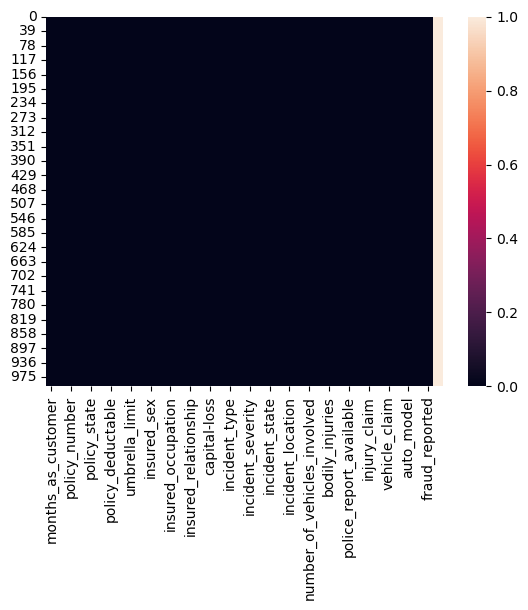

In [7]:
# Let's visualize the null values clearly
sns.heatmap(data.isnull())
plt.show()

We can clearly observe that there are no null values present in the data.

In [8]:
# Dropping _c39 column
data.drop("_c39",axis=1,inplace=True)

In [9]:
# Checking the type of dataset
data.dtypes

months_as_customer               int64
age                              int64
policy_number                    int64
policy_bind_date                object
policy_state                    object
policy_csl                      object
policy_deductable                int64
policy_annual_premium          float64
umbrella_limit                   int64
insured_zip                      int64
insured_sex                     object
insured_education_level         object
insured_occupation              object
insured_hobbies                 object
insured_relationship            object
capital-gains                    int64
capital-loss                     int64
incident_date                   object
incident_type                   object
collision_type                  object
incident_severity               object
authorities_contacted           object
incident_state                  object
incident_city                   object
incident_location               object
incident_hour_of_the_day 

The dataset contains 3 different types of data namely integer data type, float data type and object data type.

In [10]:
# Checking number of unique values in each column
data.nunique().to_frame("Nob of Unique Values")

,Nob of Unique Values
months_as_customer,391
age,46
policy_number,1000
policy_bind_date,951
policy_state,3
policy_csl,3
policy_deductable,3
policy_annual_premium,991
umbrella_limit,11
insured_zip,995


These are the unique values present in each column.

# Data Preprocessing

## Feature selection

We can observe the columns policy_number and incident_location have 1000 unique values. So it is not required for the prediction so we can drop it.

In [11]:
# Dropping policy_number and incident_location columns
data.drop("policy_number",axis=1,inplace=True)
data.drop("incident_location",axis=1,inplace=True)

Let's check the list of value counts in each columns to find if there are any unexpected or corrupted entries in the dataset

In [12]:
# Checking the value counts of each columns
for i in data.columns:
        print(data[i].value_counts())
        print('\n')

194    8
128    7
254    7
140    7
210    7
      ..
390    1
411    1
453    1
448    1
17     1
Name: months_as_customer, Length: 391, dtype: int64


43    49
39    48
41    45
34    44
38    42
30    42
31    42
37    41
33    39
40    38
32    38
29    35
46    33
42    32
35    32
36    32
44    32
28    30
26    26
45    26
48    25
47    24
27    24
57    16
25    14
55    14
49    14
53    13
50    13
24    10
54    10
61    10
51     9
60     9
58     8
56     8
23     7
21     6
59     5
62     4
52     4
64     2
63     2
19     1
20     1
22     1
Name: age, dtype: int64


01-01-2006    3
28-04-1992    3
05-08-1992    3
14-12-1991    2
09-08-2004    2
             ..
03-06-2014    1
12-12-1998    1
18-02-1999    1
30-10-1997    1
11-11-1996    1
Name: policy_bind_date, Length: 951, dtype: int64


OH    352
IL    338
IN    310
Name: policy_state, dtype: int64


250/500     351
100/300     349
500/1000    300
Name: policy_csl, dtype: int64


1000    351
500     342
2000    3

These are the list of value counts in each columns.

By looking at the value counts of each column we can realize that the columns umbrella_limit, capital-gains and capital-loss contains more zero values around 79.8%, 50.8% and 47.5%. I am keeping the zero values in capital_gains and capital_loss columns as it is. Since the umbrella_limit columns has more that 70% of zero values, let's drop that column.

Also the collision_type, police_report_available and property_damage have ? in them

In [13]:
# Dropping umbrella_limit column
data.drop("umbrella_limit",axis=1,inplace=True)

The column insured_zip is the zip code given to each person. If we take a look at the value count and unique values of the column insured_zip, it contains 995 unique values that means the 5 entries are repeating.

In [14]:
# Dropping insured_zip column as it is not important for the prediction
data.drop('insured_zip',axis=1,inplace=True)

## Features Extraction

The policy_bind_date and incident_date have object data type which should be in datetime data type that means the python is not able to understand the type of these column and giving default data type. We will convert this object data type to datetime data type and we will extract the vaues from these columns.

In [15]:
# Converting Date columns from object type into datetime data type
data['policy_bind_date']=pd.to_datetime(data['policy_bind_date'])
data['incident_date']=pd.to_datetime(data['incident_date'])


In [16]:
# Again checking the type of dataset
data.dtypes

months_as_customer                      int64
age                                     int64
policy_bind_date               datetime64[ns]
policy_state                           object
policy_csl                             object
policy_deductable                       int64
policy_annual_premium                 float64
insured_sex                            object
insured_education_level                object
insured_occupation                     object
insured_hobbies                        object
insured_relationship                   object
capital-gains                           int64
capital-loss                            int64
incident_date                  datetime64[ns]
incident_type                          object
collision_type                         object
incident_severity                      object
authorities_contacted                  object
incident_state                         object
incident_city                          object
incident_hour_of_the_day          

Now we have converted object data type into datetime data type. Now let's extract Day, Month and Year from both the columns

In [17]:
# Extracting Day, Month and Year column from policy_bind_date
data["policy_bind_Day"] = data['policy_bind_date'].dt.day
data["policy_bind_Month"] = data['policy_bind_date'].dt.month
data["policy_bind_Year"] = data['policy_bind_date'].dt.year

# Extracting Day, Month and Year column from incident_date
data["incident_Day"] = data['incident_date'].dt.day
data["incident_Month"] = data['incident_date'].dt.month
data["incident_Year"] = data['incident_date'].dt.year

Now we have extracted Day, Month and Year columns from both policy_bind_date and incident_date columns. So we can drop these columns.

In [18]:
# Dropping policy_bind_date and incident_date columns
data.drop(["policy_bind_date","incident_date"],axis=1,inplace=True)

We have dropped the columns policy_bind_date and incident_date as we have extracted the required data from those columns.

From the value counts of the columns we can also observe the some columns have "?" values, they are not NAN values but we need to fill them.

In [19]:
# Checking which columns contains "?" sign
data[data.columns[(data == '?').any()]].nunique()

collision_type             4
property_damage            3
police_report_available    3
dtype: int64

These are the columns which contains "?" sign. Since these column seems to be categorical so we will replace "?" values with most frequently occuring values of the respective columns that is their mode values.

In [20]:
# Checking mode of the above columns
print("The mode of collision_type is:",data["collision_type"].mode())
print("The mode of property_damage is:",data["property_damage"].mode())
print("The mode of police_report_available is:",data["police_report_available"].mode())

The mode of collision_type is: 0    Rear Collision
Name: collision_type, dtype: object
The mode of property_damage is: 0    ?
Name: property_damage, dtype: object
The mode of police_report_available is: 0     ?
1    NO
Name: police_report_available, dtype: object


The mode of property_damage and police_report_available is "?", which means the data is almost covered by "?" sign. So we will fill them by the second highest count of the respective column.

In [21]:
# Checking value count of property_damage column and police_report_available
print("The value count of property_damage:\n", data["property_damage"].value_counts())
print("\n")
print("The value count of police_report_available:\n", data["police_report_available"].value_counts())

The value count of property_damage:
 ?      360
NO     338
YES    302
Name: property_damage, dtype: int64


The value count of police_report_available:
 ?      343
NO     343
YES    314
Name: police_report_available, dtype: int64


Here "NO" is the second highest occured category in both property_damage and police_report_available column. We will replace "?" by "NO".

In [22]:
# Replacing "?" by their mode values
data['collision_type'] = data.collision_type.str.replace('?', data['collision_type'].mode()[0])
data['property_damage'] = data.property_damage.str.replace('?', "NO")
data['police_report_available'] = data.police_report_available.str.replace('?', "NO")

In [23]:
# Checking value count again
print("The value count of collision_type:\n", data["collision_type"].value_counts())
print("\n")
print("The value count of property_damage:\n", data["property_damage"].value_counts())
print("\n")
print("The value count of police_report_available:\n", data["police_report_available"].value_counts())

The value count of collision_type:
 Rear Collision     470
Side Collision     276
Front Collision    254
Name: collision_type, dtype: int64


The value count of property_damage:
 NO     698
YES    302
Name: property_damage, dtype: int64


The value count of police_report_available:
 NO     686
YES    314
Name: police_report_available, dtype: int64


Here we have replaced the "?" sign by mode and "NO" values.

The policy_csl column showing object data type but it contains numerical data, may be it is because of the presence of "/" in that column. So first we will extract two columns csl_per_person and csl_per_accident from policy_csl colums and then will convert their object data type into integer data type.

In [24]:
# Extracting csl_per_person and csl_per_accident from policy_csl column
data['csl_per_person'] = data.policy_csl.str.split('/', expand=True)[0]
data['csl_per_accident'] = data.policy_csl.str.split('/', expand=True)[1]

In [25]:
# Converting object data type into integer data type
data['csl_per_person']= data['csl_per_person'].astype('int64')
data['csl_per_accident'] = data['csl_per_accident'].astype('int64')

In [26]:
# Since we have extracted the data from policy_csl, let's drop that column
data.drop("policy_csl",axis=1,inplace=True)

In [27]:
# Let's extract age of the vehicle from auto_year by subtracting it from the year 2018
data["Vehicle_Age"] = 2018 - data["auto_year"]
data.drop("auto_year",axis=1, inplace = True)

Here we have extracted age of the vehicle on the basis of auto year by assuming the data is collected in the year 2018.

In [28]:
# Let's check the unique values again
data.nunique().to_frame("No of Unique Values")

,No of Unique Values
months_as_customer,391
age,46
policy_state,3
policy_deductable,3
policy_annual_premium,991
insured_sex,2
insured_education_level,7
insured_occupation,14
insured_hobbies,20
insured_relationship,6


These are the unique values present in each column after feature extraction and selection. Here incident_Year column has one unique value through out the column also it is not important for our prediction so we can drop this column.

In [29]:
# Dropping incident_Year column 
data.drop("incident_Year", axis=1, inplace=True)

In [30]:
# Let's take a look at the dataframe after preprocessing
data.head()

,months_as_customer,age,policy_state,policy_deductable,policy_annual_premium,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,...,auto_model,fraud_reported,policy_bind_Day,policy_bind_Month,policy_bind_Year,incident_Day,incident_Month,csl_per_person,csl_per_accident,Vehicle_Age
0,328,48,OH,1000,1406.91,MALE,MD,craft-repair,sleeping,husband,...,92x,Y,17,10,2014,25,1,250,500,14
1,228,42,IN,2000,1197.22,MALE,MD,machine-op-inspct,reading,other-relative,...,E400,Y,27,6,2006,21,1,250,500,11
2,134,29,OH,2000,1413.14,FEMALE,PhD,sales,board-games,own-child,...,RAM,N,9,6,2000,22,2,100,300,11
3,256,41,IL,2000,1415.74,FEMALE,PhD,armed-forces,board-games,unmarried,...,Tahoe,Y,25,5,1990,1,10,250,500,4
4,228,44,IL,1000,1583.91,MALE,Associate,sales,board-games,unmarried,...,RSX,N,6,6,2014,17,2,500,1000,9


In [31]:
data.shape

(1000, 39)

In [32]:
# Separating numerical and categorcal columns

# Checking for categorical columns
categorical_col=[]
for i in data.dtypes.index:
    if data.dtypes[i]=='object':
        categorical_col.append(i)
print("Categorical columns are:\n",categorical_col)

print('\n')

numerical_col = data.select_dtypes(include='int64')
print('numerical columns:',numerical_col.columns)

Categorical columns are:
 ['policy_state', 'insured_sex', 'insured_education_level', 'insured_occupation', 'insured_hobbies', 'insured_relationship', 'incident_type', 'collision_type', 'incident_severity', 'authorities_contacted', 'incident_state', 'incident_city', 'property_damage', 'police_report_available', 'auto_make', 'auto_model', 'fraud_reported']


numerical columns: Index(['months_as_customer', 'age', 'policy_deductable', 'capital-gains',
       'capital-loss', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'bodily_injuries', 'witnesses',
       'total_claim_amount', 'injury_claim', 'property_claim', 'vehicle_claim',
       'policy_bind_Day', 'policy_bind_Month', 'policy_bind_Year',
       'incident_Day', 'incident_Month', 'csl_per_person', 'csl_per_accident',
       'Vehicle_Age'],
      dtype='object')


In [33]:
# Checking the list of counts of target
data['fraud_reported'].unique()

array(['Y', 'N'], dtype=object)

There are two unique categories in fraud_reported column these values tells about if an insurance claim is fraudulent or not. Here we can assume that "Y" stands for "Yes" that is the insurance is fraudulent and "N" stands for "No" means the insurance claim is not fraudulent.

In [34]:
# Checking the unique values in target column
data['fraud_reported'].value_counts()

N    753
Y    247
Name: fraud_reported, dtype: int64

From the value count of the target column fraud_reported we can notice the count of the categories are different which means the data is not balanced. We will use oversampling method to balance the data before building the models.

# Statistical Summary of Dataset

In [35]:
# Statistical summary of numerical columns
data.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
months_as_customer,1000.0,NaN,NaN,NaN,203.954,115.113174,0.0,115.75,199.5,276.25,479.0
age,1000.0,NaN,NaN,NaN,38.948,9.140287,19.0,32.0,38.0,44.0,64.0
policy_state,1000,3,OH,352,NaN,NaN,NaN,NaN,NaN,NaN,NaN
policy_deductable,1000.0,NaN,NaN,NaN,1136.0,611.864673,500.0,500.0,1000.0,2000.0,2000.0
policy_annual_premium,1000.0,NaN,NaN,NaN,1256.40615,244.167395,433.33,1089.6075,1257.2,1415.695,2047.59
insured_sex,1000,2,FEMALE,537,NaN,NaN,NaN,NaN,NaN,NaN,NaN
insured_education_level,1000,7,JD,161,NaN,NaN,NaN,NaN,NaN,NaN,NaN
insured_occupation,1000,14,machine-op-inspct,93,NaN,NaN,NaN,NaN,NaN,NaN,NaN
insured_hobbies,1000,20,reading,64,NaN,NaN,NaN,NaN,NaN,NaN,NaN
insured_relationship,1000,6,own-child,183,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Here I am using the "describe" method along with it's parameter "all" to include each and every column present in our dataset irrespective of them being numeric or text data. I have also used the transpose option to make sure that we are able to see the column information properly without having to scroll through multiple times.

 The summary of this dataset looks perfect since there is no negative/ invalid values present.

From the above description we can observe the following things:

Here the counts of all the columns are equal which means there are no missing values in the dataset. In some of the columns like policy_deductable, capital-gains, injury_claim etc we can observe the mean value is greater than the median(50%) which means the data in those columns are skewed to right. And in some of the columns like total_claim_amount, vehicle_claim etc we can observe the median is greater than the mean which means the data in the columns are skewed to left. And some of the columns have equal mean and median that means the data is symmetric and is normally distributed and no skewness present. There is a huge difference in 75% and max it shows that huge outliers present in the columns.

# Data Visualization

## Univariate Analysis (Categorical Columns)

N    753
Y    247
Name: fraud_reported, dtype: int64


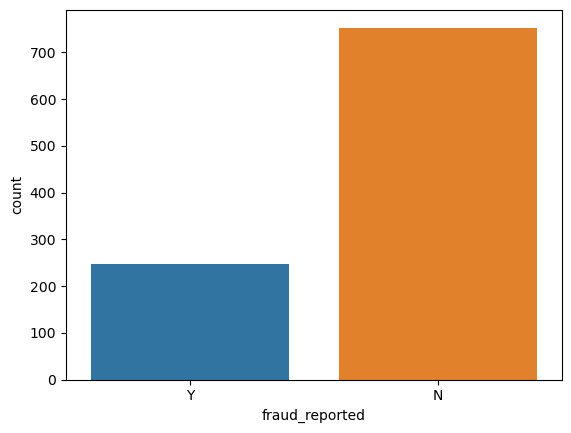

In [36]:
#Visualizing how many insurance claims is fraudulent
print(data["fraud_reported"].value_counts())
sns.countplot(x='fraud_reported',data = data)
plt.show()

From the plot we can observe that the count of "N" is high compared to "N". We can assume that "Y" stands for "Yes" that is the insurance is fraudulent and "N" stands for "No" means the insurance claim is not fraudulent. Here most of the insurance claims have not reported as fradulent.

Since it is our target column, it indicates the classes have imbalance issue. We will balance the data using oversampling method in later part.

Pie plot for the column: policy_state


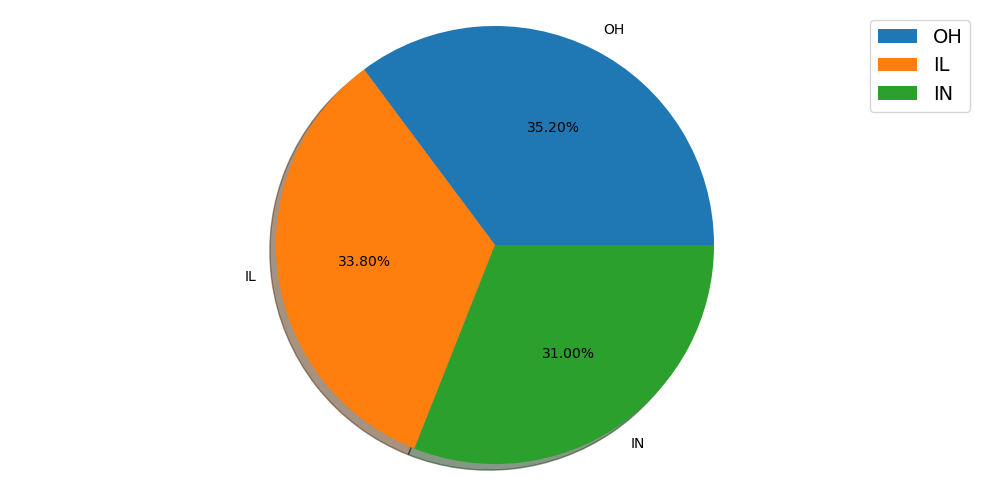

Pie plot for the column: insured_sex


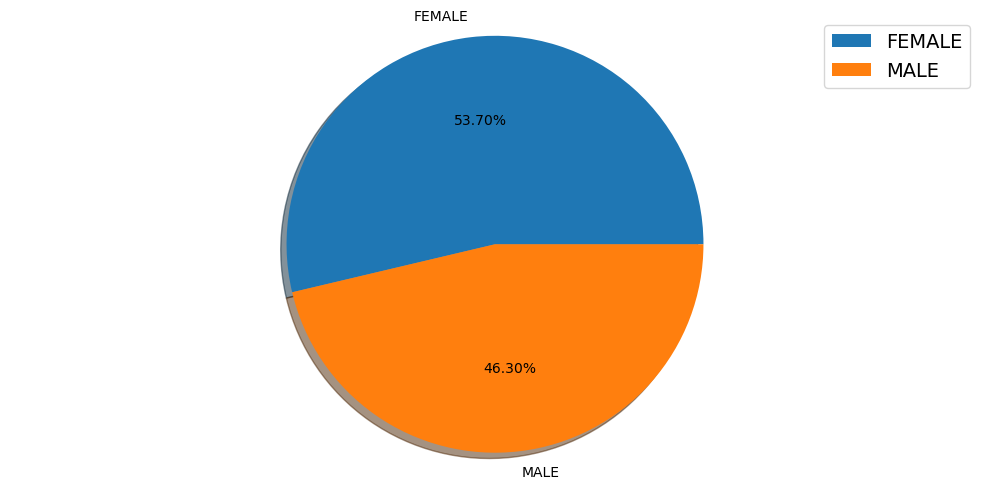

Pie plot for the column: insured_education_level


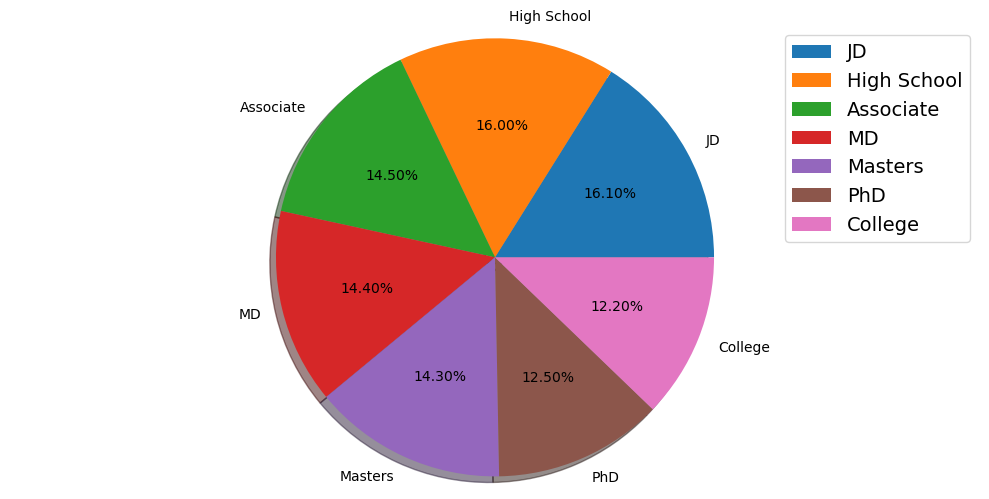

Pie plot for the column: insured_relationship


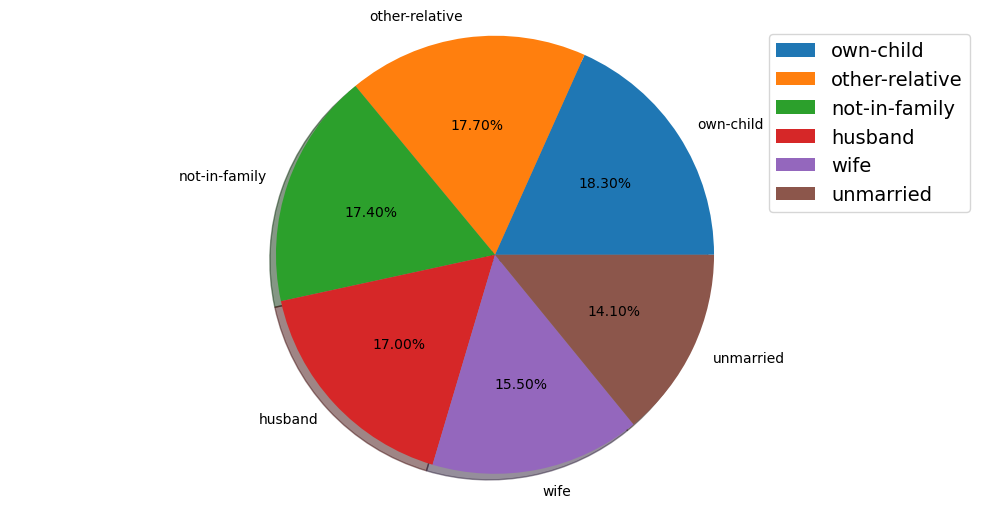

Pie plot for the column: incident_type


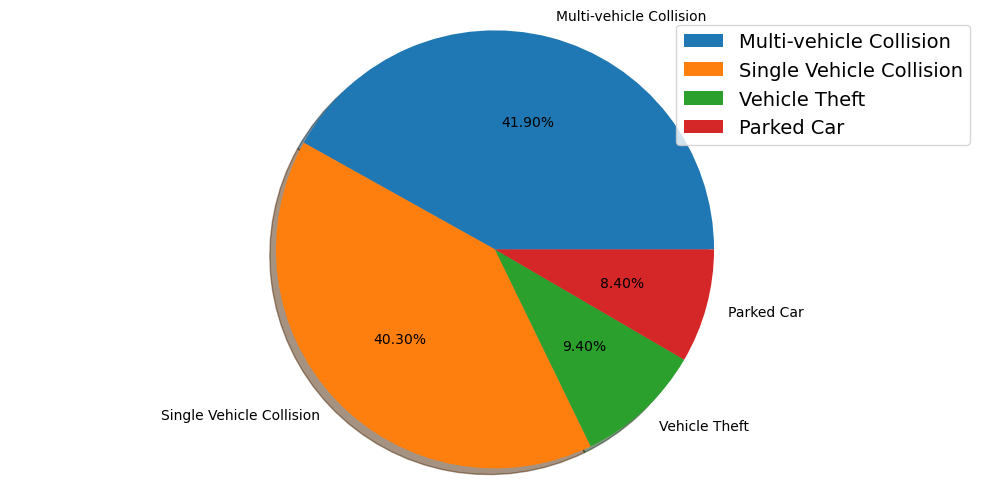

Pie plot for the column: collision_type


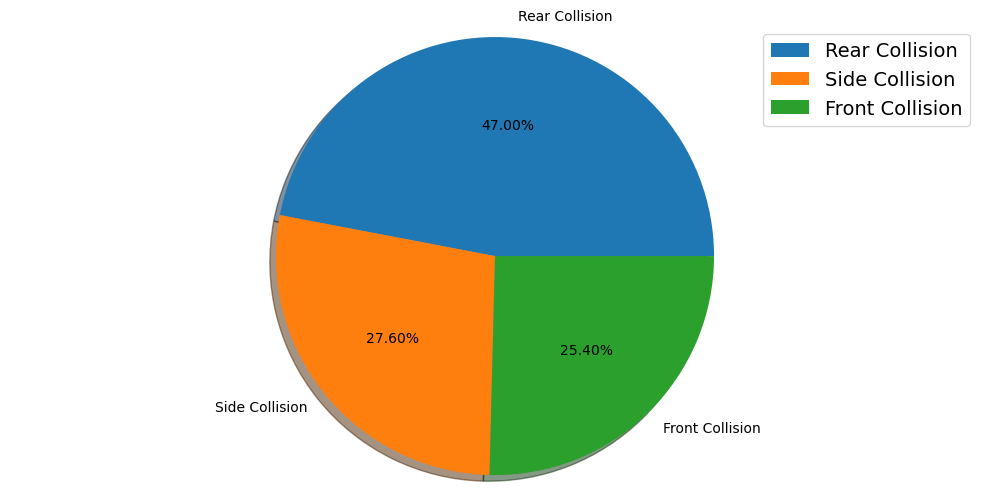

Pie plot for the column: property_damage


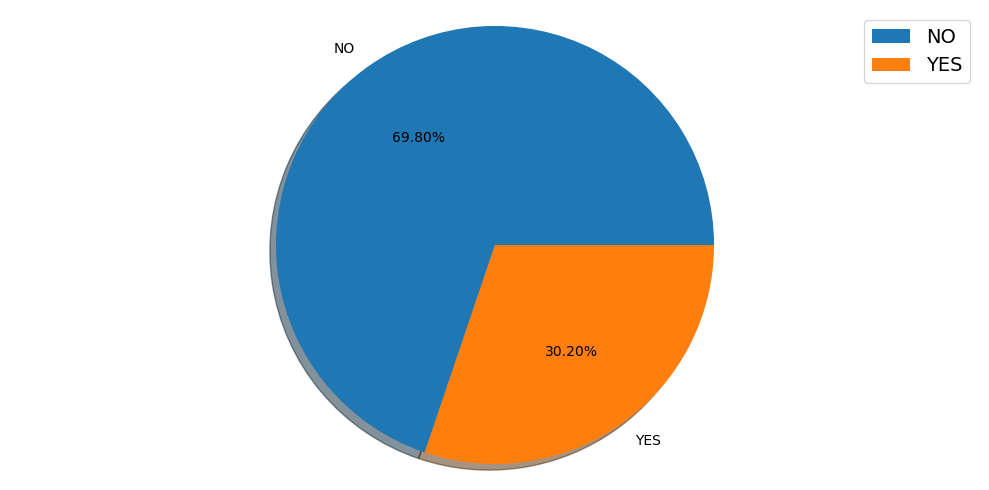

Pie plot for the column: police_report_available


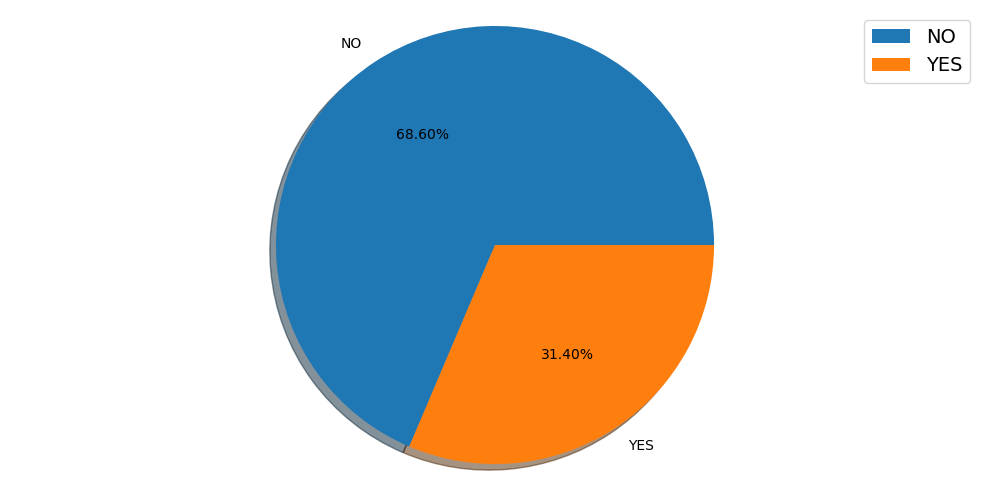

In [37]:
def generate_pie(i):
    plt.figure(figsize=(10,5))
    plt.pie(i.value_counts(), labels=i.value_counts().index, autopct='%1.2f%%',shadow=True)
    plt.legend(prop={'size':14})
    plt.axis('equal')
    plt.tight_layout()
    return plt.show()



plotnumber=1
for p in data[['policy_state', 'insured_sex', 'insured_education_level','insured_relationship', 'incident_type','collision_type','property_damage','police_report_available']]:
    print(f"Pie plot for the column:", p)
    generate_pie(data[p])

Above are the pie plots for some of the categorical columns. From the above pie plots we can observe the following things:

The types of the policies claimed by the customers are almost same but still the policy state type HO has bit high counts and the type IL has bit less count. Both male and female have insurance but the count for Female is higher than Male counts. The count is pretty much same for all the education level but still the people who have completed their college and PhD have less count compared to others. Similar to insured education, insured relationship is also almost equally distributed. While looking at the incident type, Multi-vehicle collision and Single Vehicle Collision have pretty much similar counts of around 41.9% and 40.3%. But the count is very less in Parked car and Vehicle Theft. The collision type has 3 different types . In this the count is high in Rear collision and the other two types have almost equal counts. As we observe the propert damage plot, around 69.8% of the people did not face any property damage while 30.2% of the people faced the property damage. About 68.6% of the people produced the police reports while 31.4% of the people didn't submit any police reports.

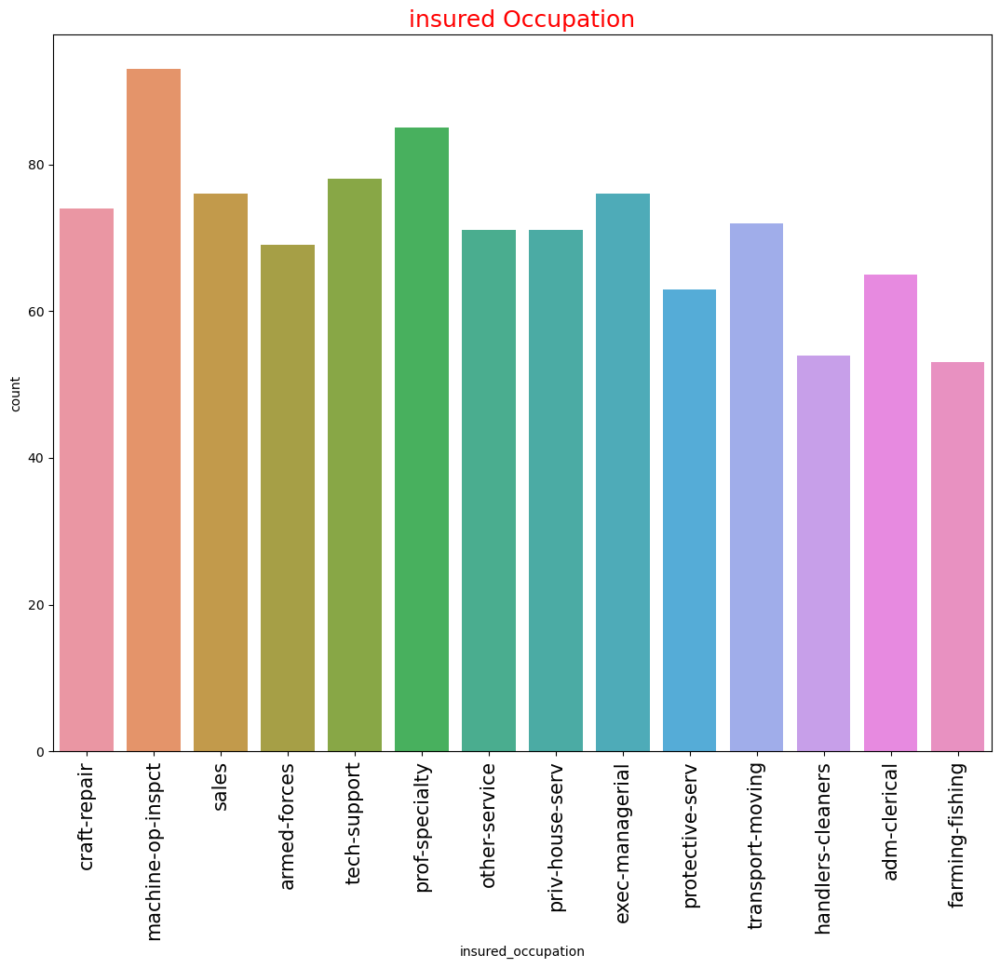

In [38]:
plt.figure(figsize=(13,10))
sns.countplot(x='insured_occupation',data = data)
plt.title('insured Occupation', fontsize=18, color ='r')
plt.xticks(rotation=90,fontsize= 15)
plt.show()

The above count plot shows customers  insured occupation and as we can see machine operation inspection has the highest number of customer, fellowed by prof speciality and the least is farming-fishing 

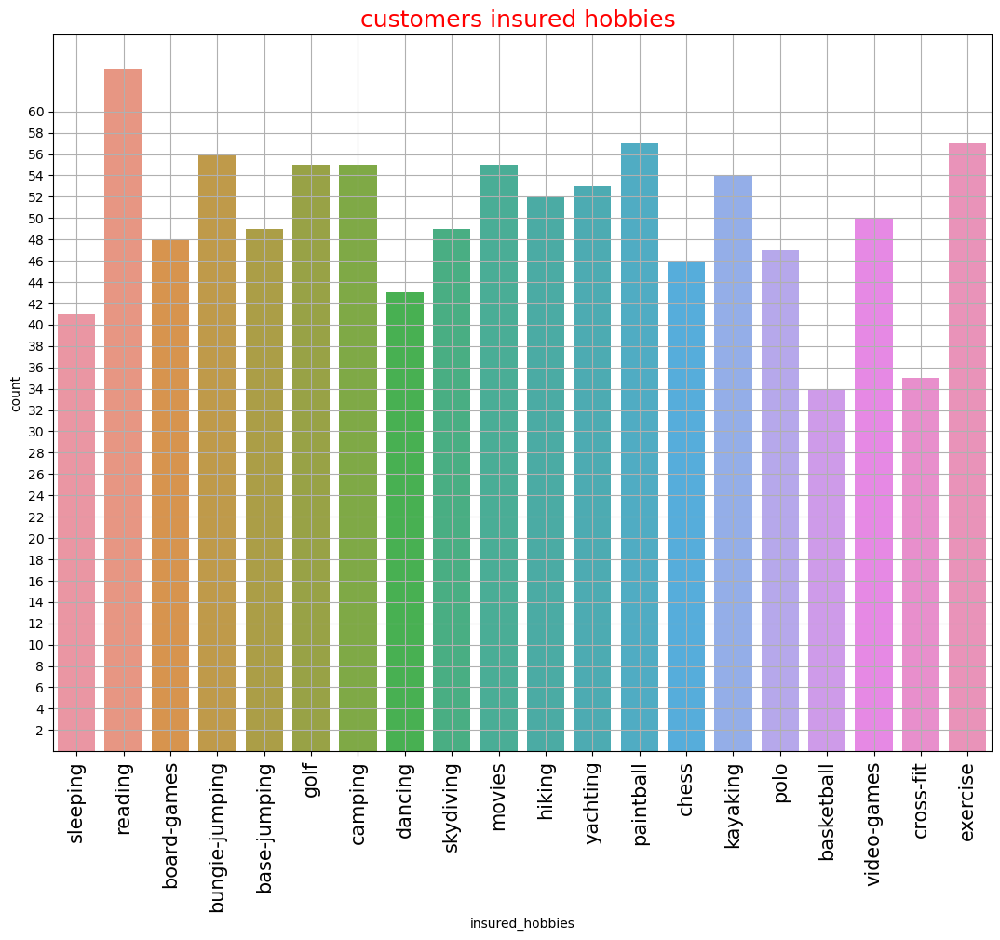

In [39]:
plt.figure(figsize=(13,10))
sns.countplot(x='insured_hobbies',data = data)
plt.title('customers insured hobbies ', fontsize=18, color ='r')
plt.xticks(rotation=90,fontsize= 15)
plt.yticks(range(2,62,2))
plt.grid(True)
plt.show()

The above plot shows customers hobbies and as we can see customers who love reading have the highest above 60, fellowed by paintball and exercise with 57 and the least groups are customers in basketball which falls in 34 

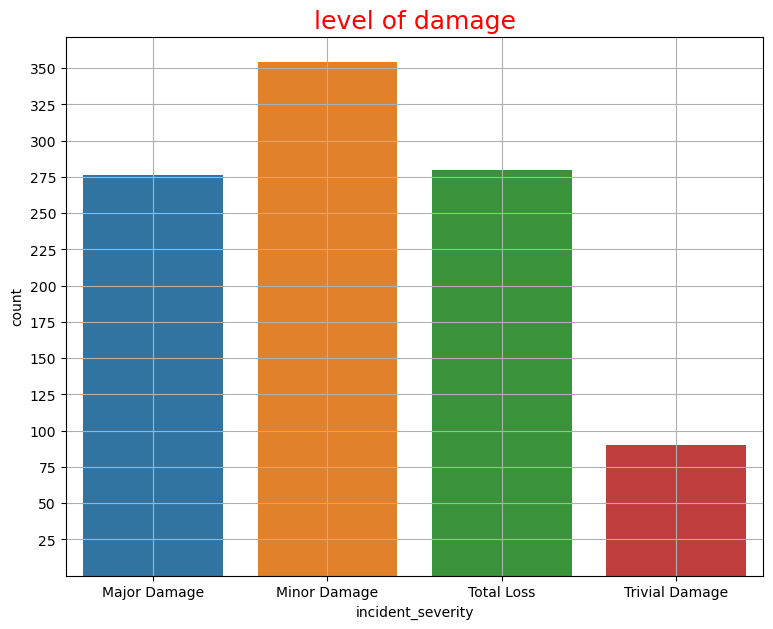

In [40]:
plt.figure(figsize=(9,7))
sns.countplot(x='incident_severity',data = data)
plt.title('level of damage', fontsize=18, color ='r')
plt.yticks(range(25,375,25))

plt.grid(True)
plt.show()

The above plot show the level or the damage of customers insured items. As we can see 350 plus customers who fell under Minor Damage are the highest, fellowed by Total Loss and the least are Trival Damage

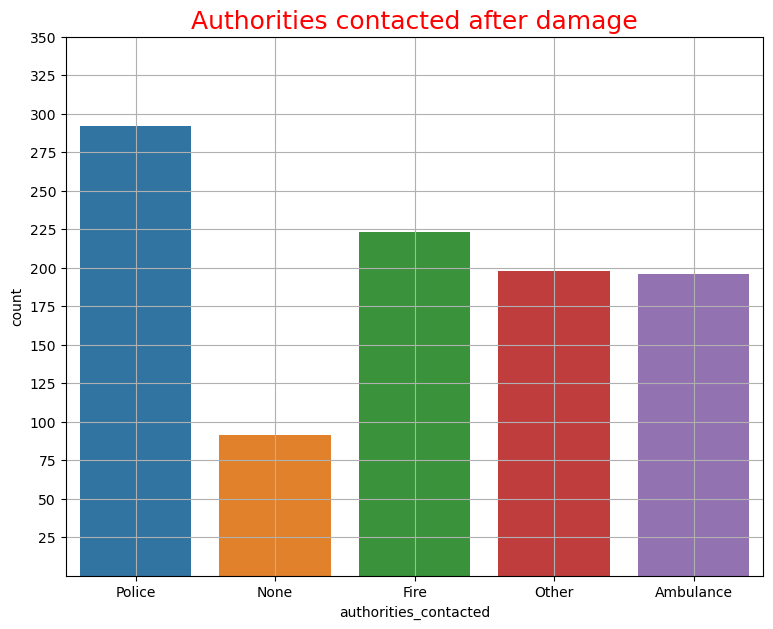

In [41]:
plt.figure(figsize=(9,7))
sns.countplot(x='authorities_contacted',data = data)
plt.title('Authorities contacted after damage', fontsize=18, color ='r')
plt.yticks(range(25,375,25))
plt.grid(True)
plt.show()

The above plot shows that almost 300 customer contact the police after damage which happens to be the highest number of government authority contacted after damage, fellowed by fire agancies which was contacted by almost 225 customers, while almost 200 customers contacted the other agancy fellowed by Ambulance. The least number of customers almost 100 did contact any government agency after incident.

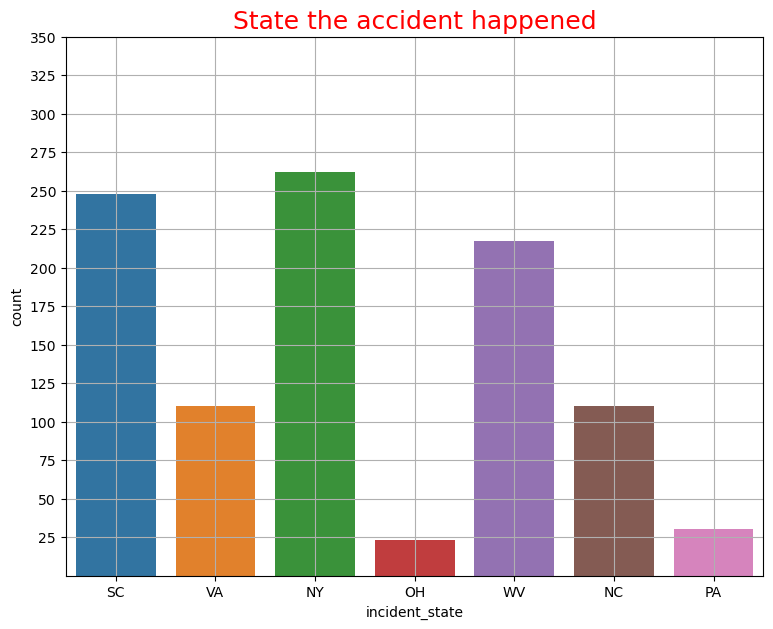

In [42]:
plt.figure(figsize=(9,7))
sns.countplot(x='incident_state',data = data)
plt.title('State the accident happened', fontsize=18, color ='r')
plt.yticks(range(25,375,25))
plt.grid(True)
plt.show()

The above plot shows the state where the inccendt happens. New York has the highest number of accident more than 250 customers, fellowed by SC almost 250 customers, while Ohoi has the least state with the number of accident less than 25 customers 

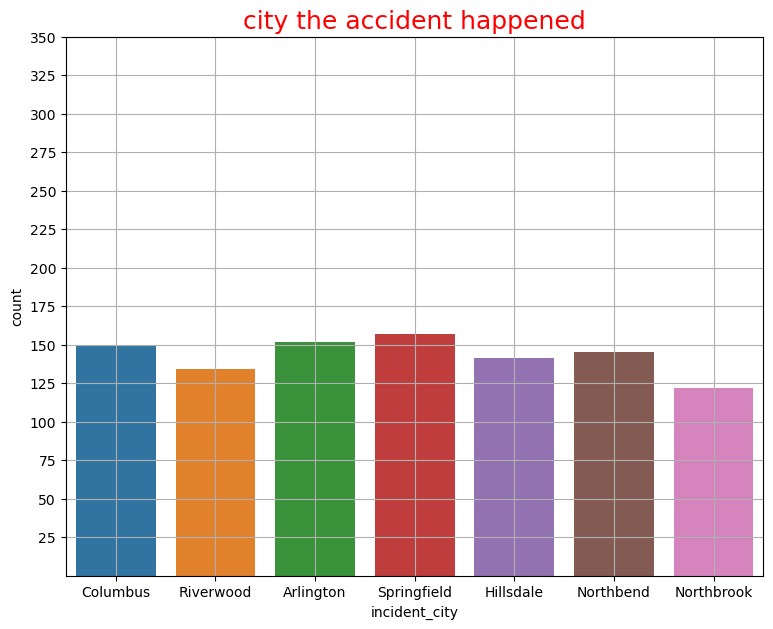

In [43]:
plt.figure(figsize=(9,7))
sns.countplot(x='incident_city',data = data)
plt.title('city the accident happened', fontsize=18, color ='r')
plt.yticks(range(25,375,25))
plt.grid(True)
plt.show()

According to the above plot Sprngfield city has the highest number of accident fellowed by Arlighton, the least is Northbrook city 

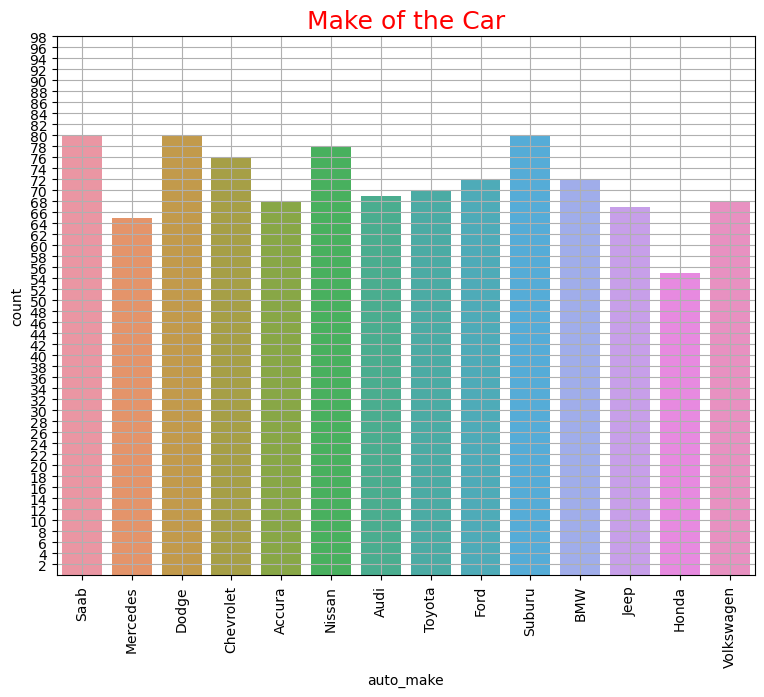

In [44]:
plt.figure(figsize=(9,7))
sns.countplot(x='auto_make',data = data)
plt.title('Make of the Car', fontsize=18, color ='r')
plt.yticks(range(2,100,2))
plt.xticks(rotation=90)
plt.grid(True)
plt.show()

According to the above plot 80 customers using Saab, 80  customers using  Dodge car, 80 customers using Suburu  have the highest of car make accident and the least is Honda about 55 customers using that make of car.

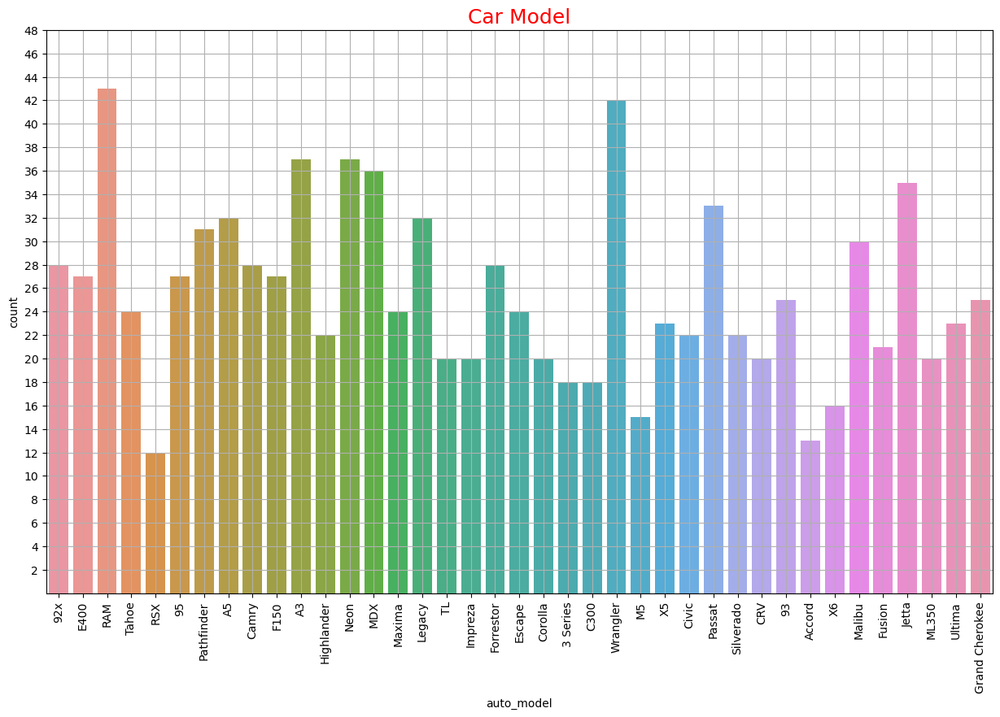

In [45]:
plt.figure(figsize=(15,9))
sns.countplot(x='auto_model',data = data)
plt.title('Car Model', fontsize=18, color ='r')
plt.yticks(range(2,50,2))
plt.xticks(rotation=90)
plt.grid(True)
plt.show()

The above car shows the model of the car customers using in getting accident. Customers using Ram model are the highest fellowed by Wrangler and the least is RSX

# Checking the Distribution of the dataset(numerical columns)

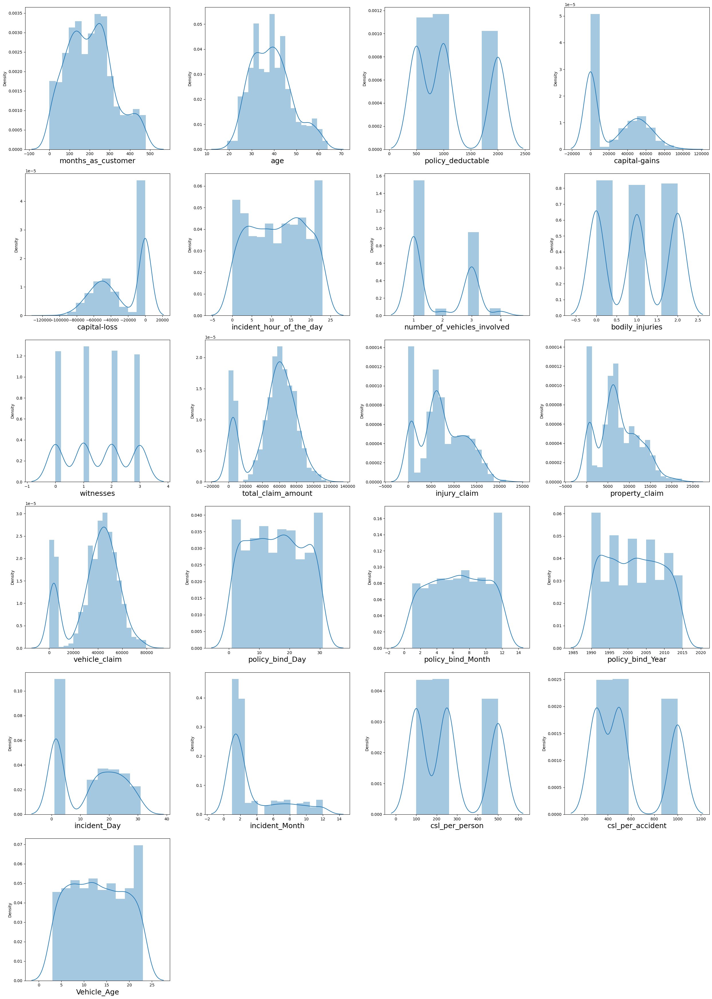

In [413]:
# Checking how the data has been distriubted in each column
plt.figure(figsize=(25,35),facecolor='white')
plotnumber=1
for column in numerical_col:
    if plotnumber<=23:
        ax=plt.subplot(6,4,plotnumber)
        sns.distplot(data[column])
        plt.xlabel(column,fontsize=18)
    plotnumber+=1
plt.tight_layout()

Above are the distribution plots for all the numerical columns. From the distplots we can observe the following things:

The data is normally distributed in most of the columns. Some of the columns like capital gains and incident months have mean value greater than the median, hence they are skewed to left. The data in the column capital loss is skewed to right since the median is greater than the mean. We will remove the skewness using appropriate methods in the later part.

# Bivariate Analysis

Text(0.5, 1.0, 'age vs fraud reported ')

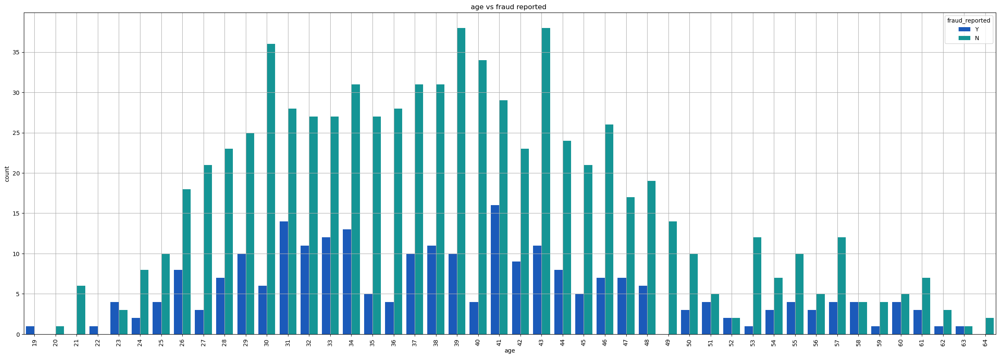

In [46]:
plt.figure(figsize=(30,10))
sns.countplot(x='age',hue='fraud_reported',data=data,palette='winter')
plt.grid(True)
plt.xticks(rotation=90)
plt.title('age vs fraud reported ')

Customers with age 43yrs old have the high fraud reported compared to others.

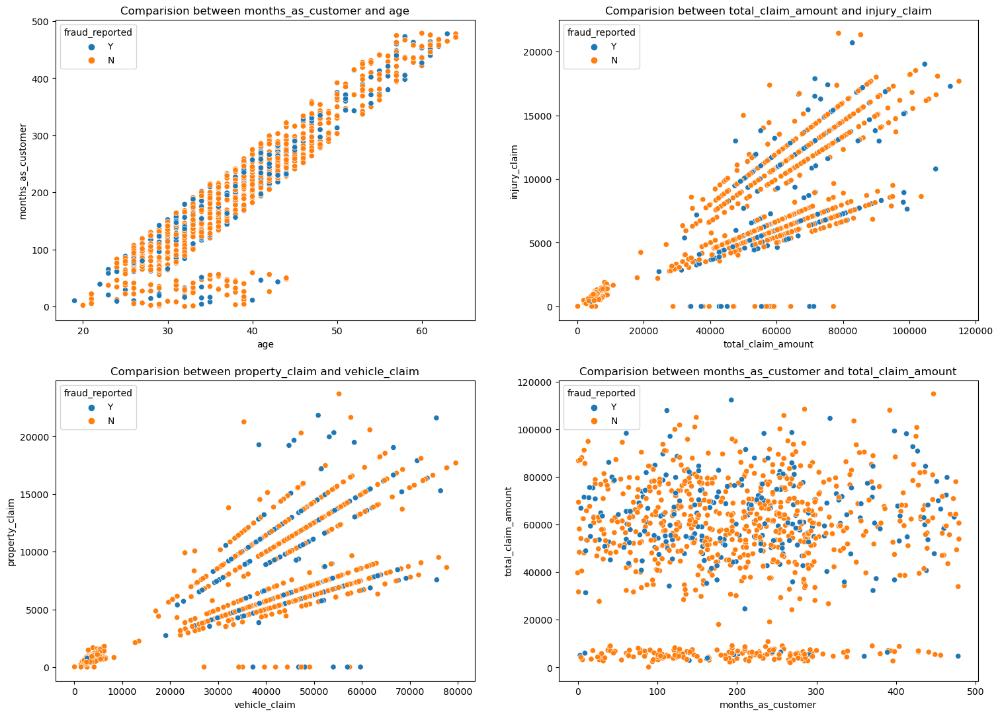

In [47]:
# Comparision between two variables
plt.figure(figsize=[18,13])

plt.subplot(2,2,1)
plt.title('Comparision between months_as_customer and age')
sns.scatterplot(y='months_as_customer',x='age', hue ='fraud_reported',data=data);


plt.subplot(2,2,2)
plt.title('Comparision between total_claim_amount and injury_claim')
sns.scatterplot(y='injury_claim',x='total_claim_amount',hue='fraud_reported',data=data);

plt.subplot(2,2,3)
plt.title('Comparision between property_claim and vehicle_claim')
sns.scatterplot(y='property_claim',x='vehicle_claim',hue='fraud_reported',data=data);

plt.subplot(2,2,4)
plt.title('Comparision between months_as_customer and total_claim_amount')
sns.scatterplot(y='total_claim_amount', x='months_as_customer', hue = 'fraud_reported', data=data);

From the above scatter plot we can observe the following things:

There is a positive linear relation between age and month_as_customer column. As age increases the month_as customers also increases, also the fraud reported is very less in hits case. In the second graph we can observe the positive linear relation, as total claim amount increases, injury claim is also increases. Third plot is also same as second one that is as the property claim increases, vehicle claim also increases. In the fourth plot we can observe the data is scattered and there is no much relation between the features.

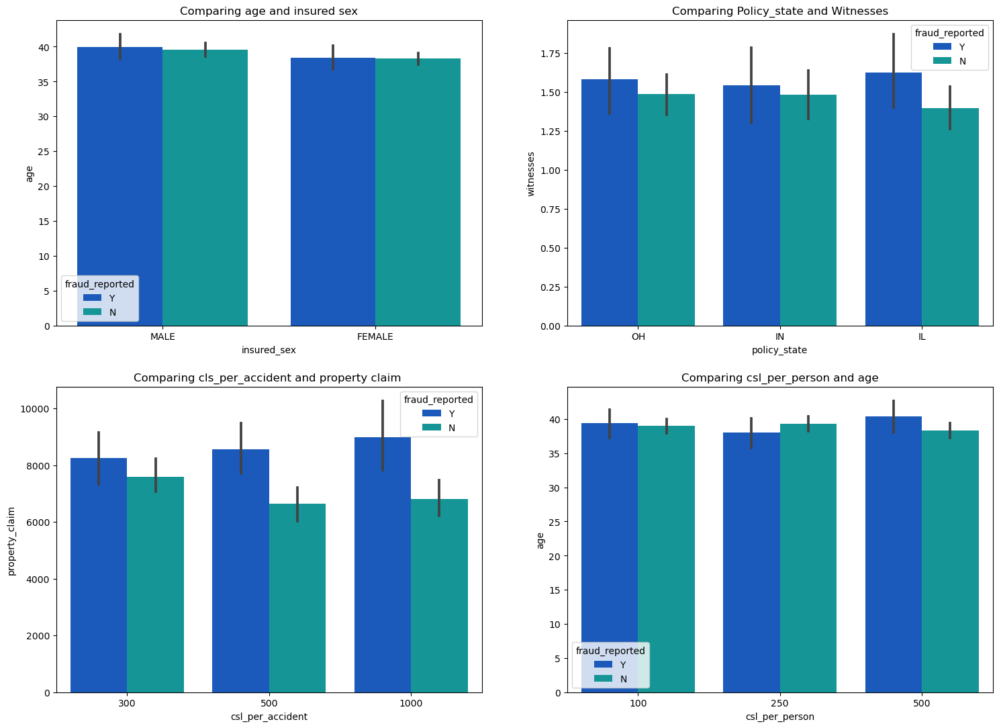

In [48]:
plt.figure(figsize=[18,13])

plt.subplot(2,2,1)
plt.title('Comparing age and insured sex')
sns.barplot(y='age',x='insured_sex', hue ='fraud_reported',data=data, palette='winter');


plt.subplot(2,2,2)
plt.title('Comparing Policy_state and Witnesses')
sns.barplot(y='witnesses',x='policy_state',hue='fraud_reported',data=data,palette='winter');

plt.subplot(2,2,3)
plt.title('Comparing cls_per_accident and property claim ')
sns.barplot(y='property_claim',x='csl_per_accident',hue='fraud_reported',data=data,palette='winter');

plt.subplot(2,2,4)
plt.title('Comparing csl_per_person and age')
sns.barplot(y='age', x='csl_per_person', hue = 'fraud_reported', data=data,palette='winter');

The fraud report is high for both the males females having age between 30-45. The people who own the policy state "IL" have high fraud report. The person who has csl per accident insurance by claiming property in the range 8000-10000 have the fraud report. The csl_per_person with age 30-45 are facing the fraudulent reports.

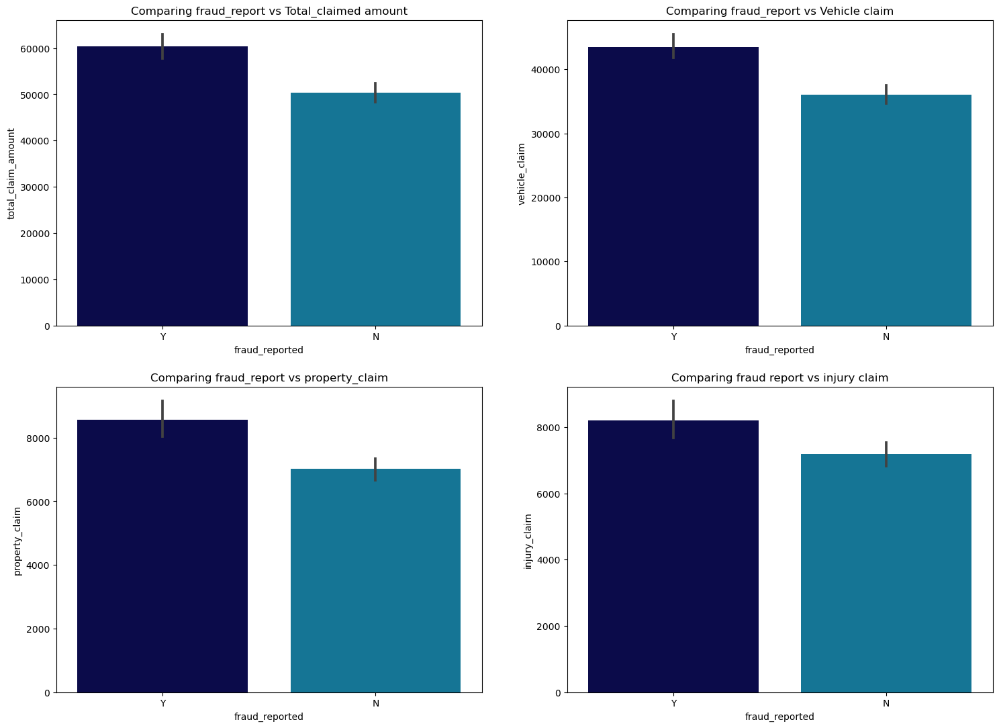

In [49]:
plt.figure(figsize=[18,13])

plt.subplot(2,2,1)
plt.title('Comparing fraud_report vs Total_claimed amount')
sns.barplot(y='total_claim_amount',x='fraud_reported',data=data, palette='ocean');


plt.subplot(2,2,2)
plt.title('Comparing fraud_report vs Vehicle claim')
sns.barplot(y='vehicle_claim',x='fraud_reported',data=data,palette='ocean');

plt.subplot(2,2,3)
plt.title('Comparing fraud_report vs property_claim')
sns.barplot(y='property_claim',x='fraud_reported',data=data,palette='ocean');

plt.subplot(2,2,4)
plt.title('Comparing fraud report vs injury claim')
sns.barplot(y='injury_claim', x='fraud_reported', data=data,palette='ocean');

The first plot shows they reported fraud when the claimed amount was beyond 60,000. Amunt claimed without any fraud was between 50,000 to 57,000

Second plot shows fraud was reported when vehicle claim that was damaged during accident was 40,000 above. While vehiclaim were no fraud was report during damage was 30,000 to 37,000

Third plot shows fraud was reported when property claim during damage was  above 8000 and not  reported fraud when property claim was 7500

Fourth plot shows fraud was reported when injury claim during accident was above 800 and fraud was not reported when injury claimed during accident was close to 8000 

Text(0.5, 1.0, 'policy state vs fraud reported vs RainTomorrow')

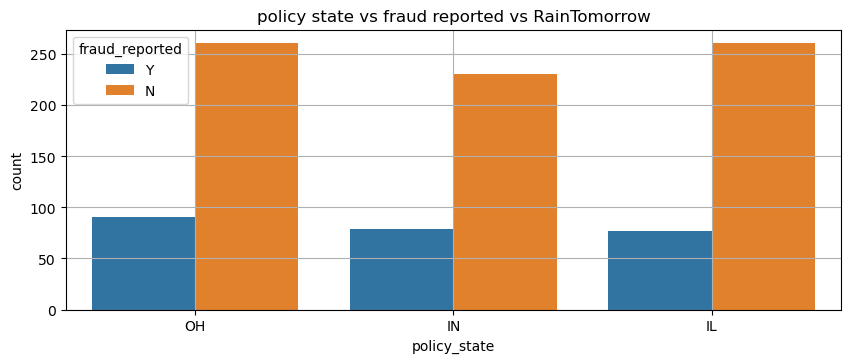

In [50]:
plt.figure(figsize=(10,8))
plt.subplot(2,1,1)
sns.countplot(x='policy_state',hue='fraud_reported',data=data)
plt.grid(True)
plt.title('policy state vs fraud reported vs RainTomorrow')

Fraud reported in Ohio "OH" is higher than 'IN' and 'IL'

Text(0.5, 1.0, 'insured_occupation vs fraud reported ')

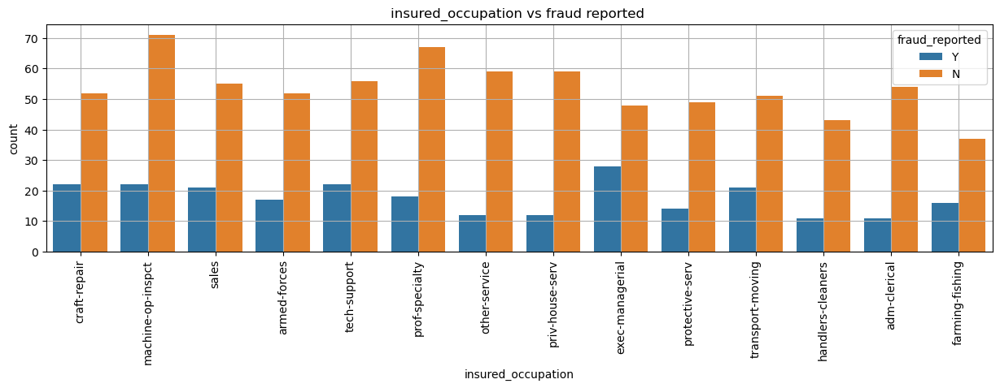

In [51]:
plt.figure(figsize=(15,8))
plt.subplot(2,1,1)
sns.countplot(x='insured_occupation',hue='fraud_reported',data=data)
plt.xticks(rotation=90)
plt.grid(True)
plt.title('insured_occupation vs fraud reported ')

Executive managerial has the highest fraud level reported while machine operation inspection has the highest in no fraud  

Text(0.5, 1.0, 'insured_education_level vs fraud reported ')

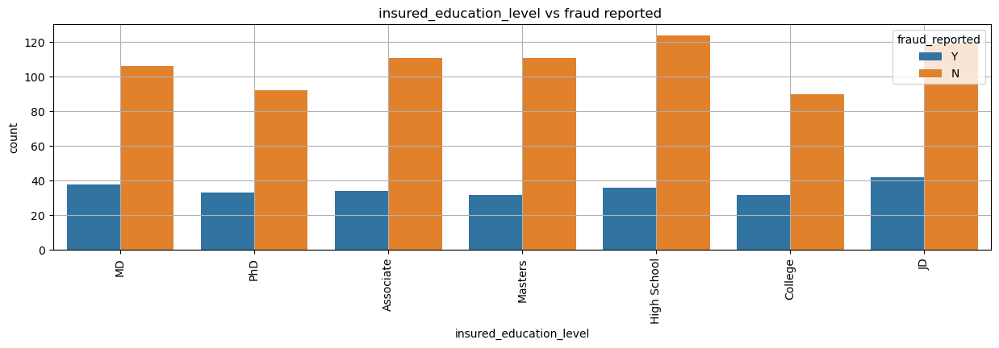

In [52]:
plt.figure(figsize=(15,8))
plt.subplot(2,1,1)
sns.countplot(x='insured_education_level',hue='fraud_reported',data=data)
plt.xticks(rotation=90)
plt.grid(True)
plt.title('insured_education_level vs fraud reported ')

customers whose level of education is 'JD' the highest number of fraud reported while cutomers in High school level of education have highest number of no fraud 

Text(0.5, 1.0, 'insured_hobbies vs fraud reported ')

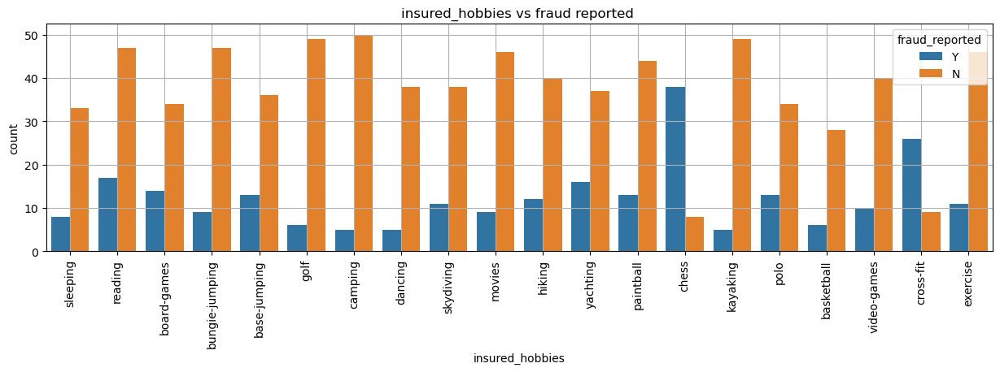

In [53]:
plt.figure(figsize=(15,8))
plt.subplot(2,1,1)
sns.countplot(x='insured_hobbies',hue='fraud_reported',data=data)
plt.xticks(rotation=90)
plt.grid(True)
plt.title('insured_hobbies vs fraud reported ')

The fraud report is high for the people who have the hobby of playing chess and cross fit.

Text(0.5, 1.0, 'insured_relationship vs fraud reported ')

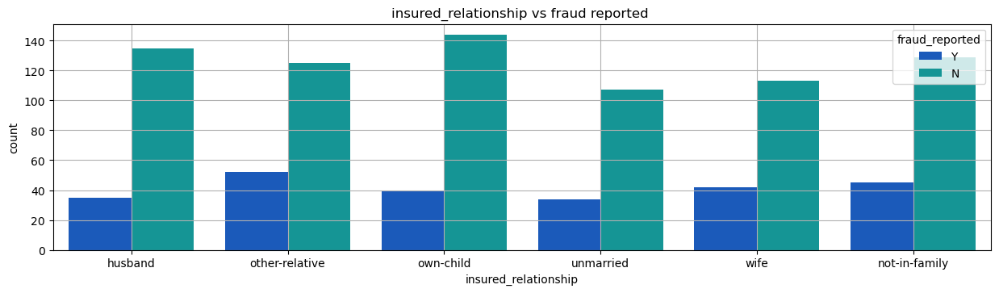

In [54]:
plt.figure(figsize=(15,8))
plt.subplot(2,1,1)
sns.countplot(x='insured_relationship',hue='fraud_reported',data=data,palette='winter')
plt.grid(True)
plt.title('insured_relationship vs fraud reported ')

The fraud report is high for customers who have other relative and it is very less for unmarried people.

Text(0.5, 1.0, 'incident_type vs fraud reported ')

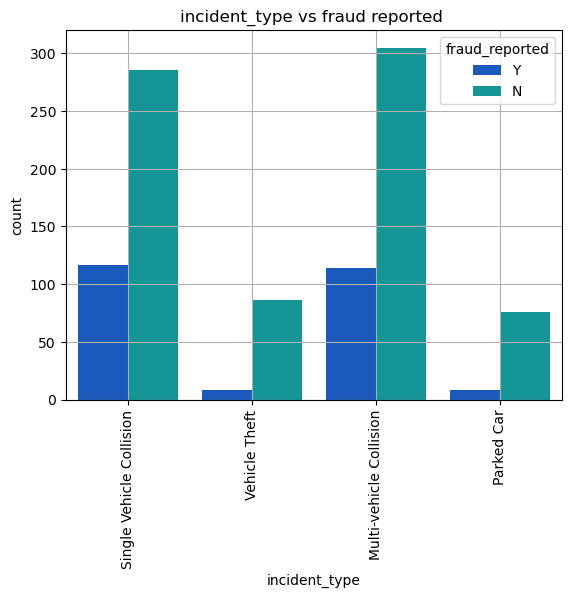

In [55]:
plt.figure()
sns.countplot(x='incident_type',hue='fraud_reported',data=data,palette='winter')
plt.grid(True)
plt.xticks(rotation=90)
plt.title('incident_type vs fraud reported ')

In Multivehicle collission and single vehicle collision, the fraud report are the highest compared to others.

Text(0.5, 1.0, 'collision_type vs fraud reported ')

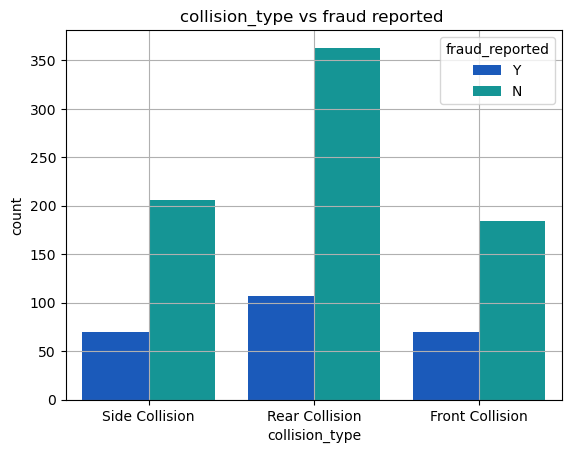

In [56]:
plt.figure()
sns.countplot(x='collision_type',hue='fraud_reported',data=data,palette='winter')
plt.grid(True)
plt.title('collision_type vs fraud reported ')

The fraud level is high in the collision type Rear Collision compare to the other two collision type with same reports.

Text(0.5, 1.0, 'incident_severity vs fraud reported ')

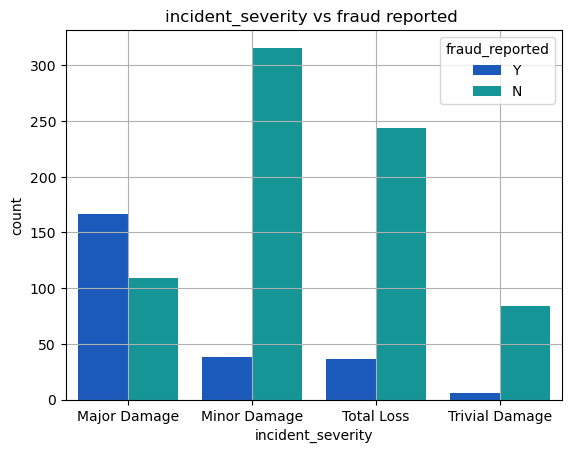

In [57]:
plt.figure()
sns.countplot(x='incident_severity',hue='fraud_reported',data=data,palette='winter')
plt.grid(True)
plt.title('incident_severity vs fraud reported ')

The fraud report is high in Major damage incident severity and for Trivial Damage the report is less compared to others.

Text(0.5, 1.0, 'authorities_contacted vs fraud reported ')

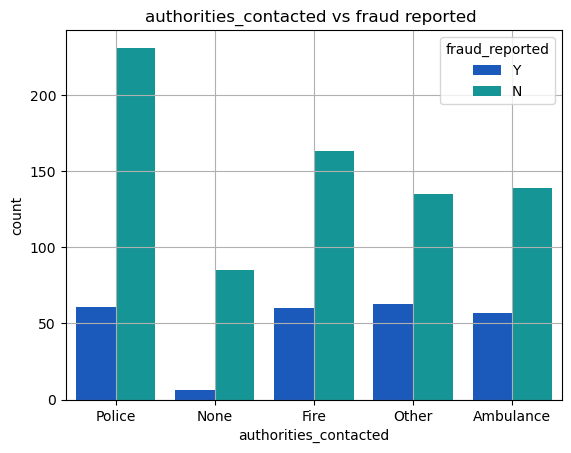

In [58]:
plt.figure()
sns.countplot(x='authorities_contacted',hue='fraud_reported',data=data,palette='winter')
plt.grid(True)
plt.title('authorities_contacted vs fraud reported ')

The police contacted cases are very high and the fraud report is in equal between fire and other except None.

Text(0.5, 1.0, 'incident_state vs fraud reported ')

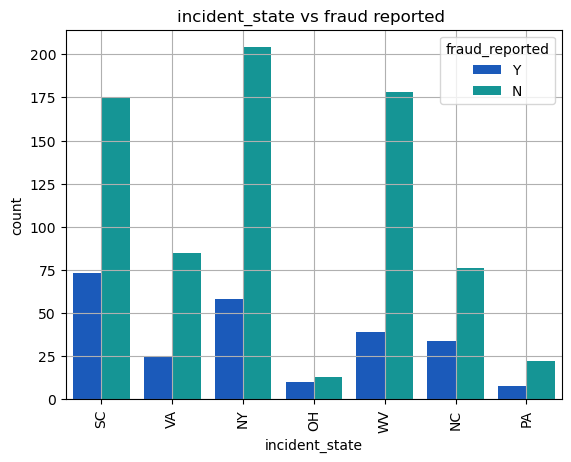

In [59]:
plt.figure()
sns.countplot(x='incident_state',hue='fraud_reported',data=data,palette='winter')
plt.grid(True)
plt.xticks(rotation=90)
plt.title('incident_state vs fraud reported ')

The state SC has high fraud reports compared to other states.

Text(0.5, 1.0, 'incident_city vs fraud reported ')

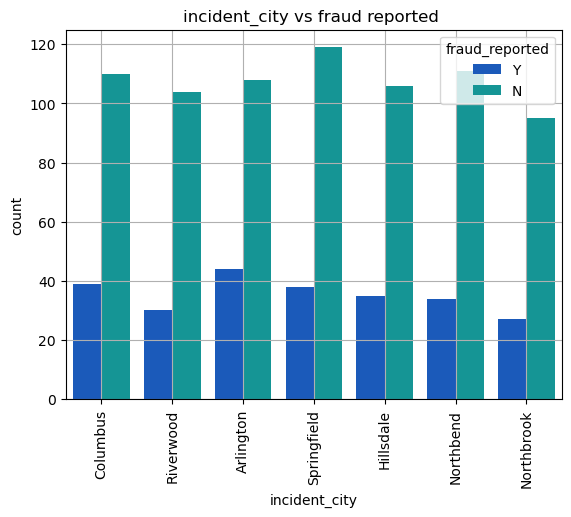

In [60]:
plt.figure()
sns.countplot(x='incident_city',hue='fraud_reported',data=data,palette='winter')
plt.grid(True)
plt.xticks(rotation=90)
plt.title('incident_city vs fraud reported ')

The cities Arlington has the highest fraud report fellowed by  Columbus and Springfield compared to others.

Text(0.5, 1.0, 'property_damage vs fraud reported ')

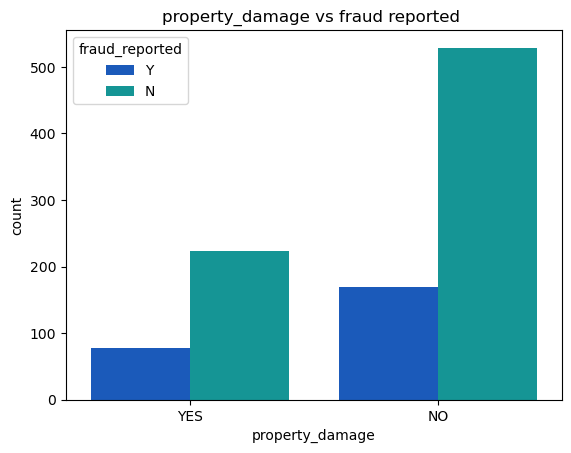

In [61]:
plt.figure()
sns.countplot(x='property_damage',hue='fraud_reported',data=data,palette='winter')
plt.title('property_damage vs fraud reported ')

The customers who do not have any property damage case they have high fraud reports.

Text(0.5, 1.0, 'police_report_availablevs fraud reported ')

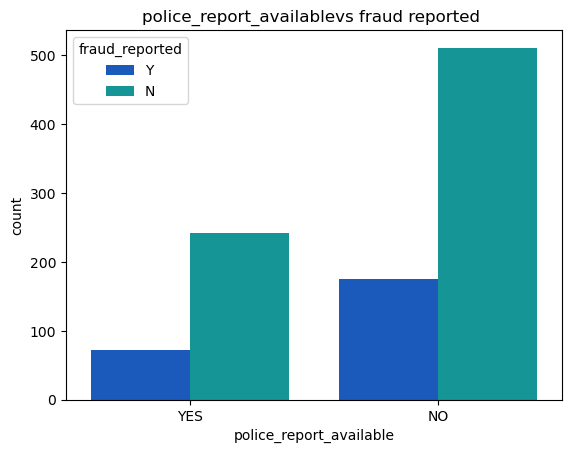

In [62]:
plt.figure()
sns.countplot(x='police_report_available',hue='fraud_reported',data=data,palette='winter')
plt.title('police_report_availablevs fraud reported ')

If there is no police report available then the fraud report is very high.

Text(0.5, 1.0, 'auto make vs fraud reported ')

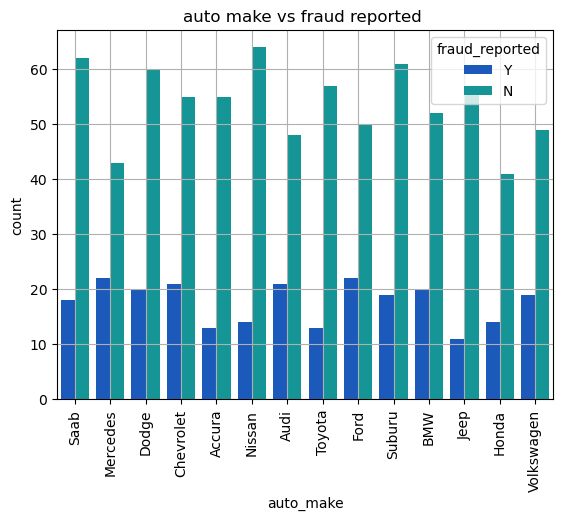

In [63]:
plt.figure()
sns.countplot(x='auto_make',hue='fraud_reported',data=data,palette='winter')
plt.grid(True)
plt.xticks(rotation=90)
plt.title('auto make vs fraud reported ')

In all the auto make cases Mercedes,Ford,Audi and Chevrolet have the highest fraud cases compared to others auto make 

# Multivariate Analysis

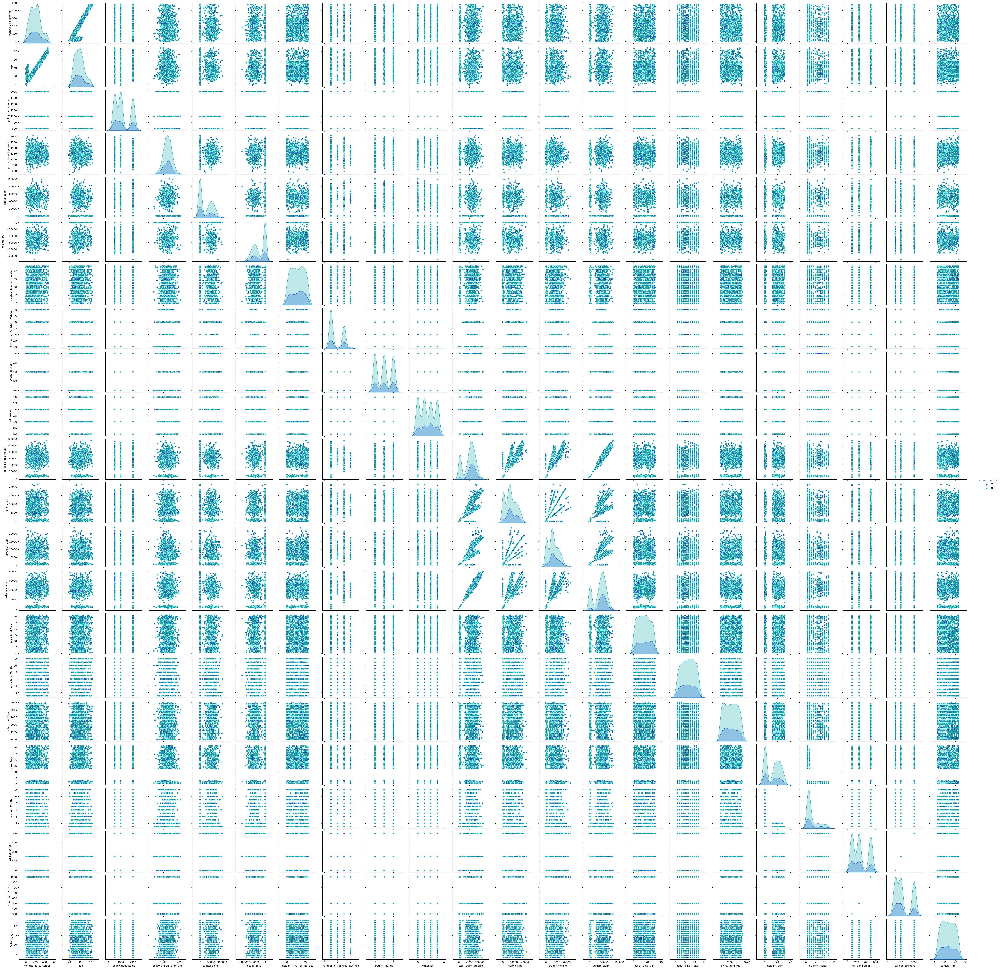

In [64]:
sns.pairplot(data,hue="fraud_reported",palette="winter")
plt.show()

In the pairplot we can see the relationbetween each variable with respect to other variables

# Identifying the outliers

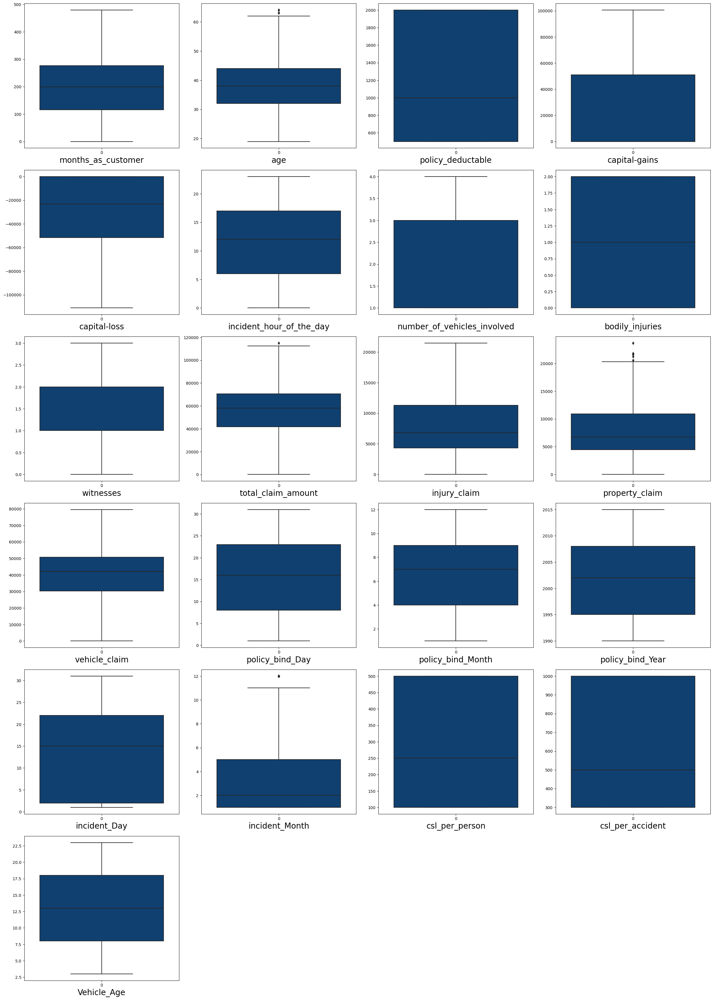

In [65]:
# Let's check the outliers by ploting box plot

plt.figure(figsize=(25,35),facecolor='white')
plotnumber=1
for column in numerical_col:
    if plotnumber<=23:
        ax=plt.subplot(6,4,plotnumber)
        sns.boxplot(data[column],palette="ocean")
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.tight_layout()

Columns with outliers:

age policy_annual_premium , total_claim_amount , property_claim and incident_month.


# Removing outliers using Z score.

In [66]:
from scipy.stats import zscore
z_score = zscore(data[['age','policy_annual_premium','total_claim_amount','property_claim','incident_Month']])
abs_z_score = np.abs(z_score) 
filtering_entry = (abs_z_score  < 3).all(axis=1)

new_data = data[filtering_entry]
print('Old Data Frame:', data.shape[0])
print('New Data Frame:', new_data.shape[0])
print('percentage of loss of data by zscore is :',(data.shape[0]-new_data.shape[0])/data.shape[0],'%')

Old Data Frame: 1000
New Data Frame: 996
percentage of loss of data by zscore is : 0.004 %


In [67]:
new_data.head()

,months_as_customer,age,policy_state,policy_deductable,policy_annual_premium,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,...,auto_model,fraud_reported,policy_bind_Day,policy_bind_Month,policy_bind_Year,incident_Day,incident_Month,csl_per_person,csl_per_accident,Vehicle_Age
0,328,48,OH,1000,1406.91,MALE,MD,craft-repair,sleeping,husband,...,92x,Y,17,10,2014,25,1,250,500,14
1,228,42,IN,2000,1197.22,MALE,MD,machine-op-inspct,reading,other-relative,...,E400,Y,27,6,2006,21,1,250,500,11
2,134,29,OH,2000,1413.14,FEMALE,PhD,sales,board-games,own-child,...,RAM,N,9,6,2000,22,2,100,300,11
3,256,41,IL,2000,1415.74,FEMALE,PhD,armed-forces,board-games,unmarried,...,Tahoe,Y,25,5,1990,1,10,250,500,4
4,228,44,IL,1000,1583.91,MALE,Associate,sales,board-games,unmarried,...,RSX,N,6,6,2014,17,2,500,1000,9


# Checking skewness in the data

In [68]:
# Checking the skewness
new_data.skew().sort_values()

vehicle_claim                 -0.619755
total_claim_amount            -0.593473
capital-loss                  -0.393015
incident_hour_of_the_day      -0.039123
policy_bind_Month             -0.029722
bodily_injuries                0.011117
witnesses                      0.025758
policy_bind_Day                0.028923
policy_annual_premium          0.032042
Vehicle_Age                    0.049276
incident_Day                   0.055659
policy_bind_Year               0.058499
injury_claim                   0.267970
property_claim                 0.357130
months_as_customer             0.359605
csl_per_person                 0.413713
policy_deductable              0.473229
age                            0.474526
capital-gains                  0.478850
number_of_vehicles_involved    0.500364
csl_per_accident               0.609316
incident_Month                 1.377097
dtype: float64

These are the features with skewness total_claim_amount vehicle_claim incident_Month csl_per_accident

# Removing Skewness using yeo-johnson method

In [69]:
# Removing skewness using yeo-johnson method to get better prediction

skew = ["total_claim_amount","vehicle_claim","incident_Month","csl_per_accident"]

trans_f = PowerTransformer(method='yeo-johnson')

In [70]:
new_data[skew] = trans_f.fit_transform(new_data[skew].values)
new_data[skew].head(10)

,total_claim_amount,vehicle_claim,incident_Month,csl_per_accident
0,0.717556,0.754553,-1.101370,0.052612
1,-1.777785,-1.787353,-1.101370,0.052612
2,-0.716483,-0.820820,-0.026479,-1.174021
3,0.392931,0.678427,1.553647,0.052612
4,-1.730555,-1.740710,-0.026479,1.313327
5,0.420495,0.709752,-0.026479,0.052612
6,0.998112,0.640989,-1.101370,0.052612
7,-0.068549,-0.304469,-0.026479,-1.174021
8,-0.976153,-0.869814,-1.101370,-1.174021
9,-0.426215,-0.300701,1.056606,-1.174021


In [71]:
# Checking skewness after using yeo-johnson ethod
new_data[skew].skew().sort_values()

vehicle_claim        -0.521354
total_claim_amount   -0.508953
csl_per_accident      0.110964
incident_Month        0.305741
dtype: float64

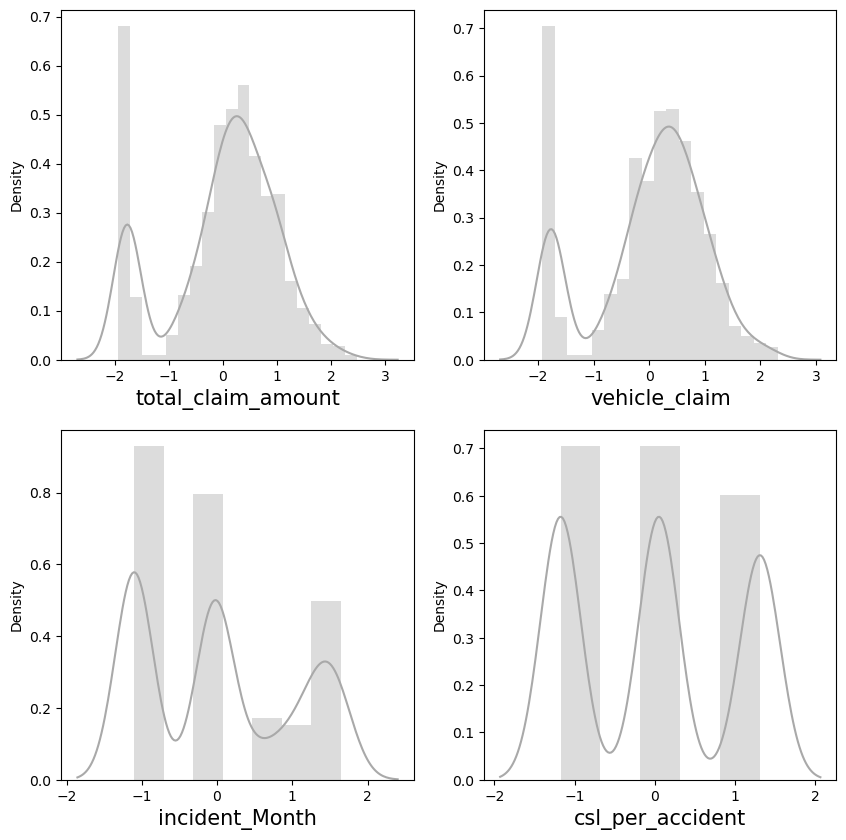

In [72]:
# After removing skewness let's check how the data has been distributed in each column.

plt.figure(figsize=(10,10), facecolor='white')
plotnumber = 1

for column in new_data[skew]:
    if plotnumber<=4:
        ax = plt.subplot(2,2,plotnumber)
        sns.distplot(new_data[column],color='darkgrey')
        plt.xlabel(column,fontsize=15)
    plotnumber+=1
plt.show()

The data distribution fellows a bell curve and looks better after removing the skewness compared to the previous data.

## Encoding the categorical columns using Label Encoding

In [73]:
le=LabelEncoder()
for i in new_data[categorical_col]:
    new_data[i]=le.fit_transform(new_data[i])


In [74]:
new_data[categorical_col].head()

,policy_state,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,property_damage,police_report_available,auto_make,auto_model,fraud_reported
0,2,1,4,2,17,0,2,2,0,4,4,1,1,1,10,1,1
1,1,1,4,6,15,2,3,1,1,4,5,5,0,0,8,12,1
2,2,0,6,11,2,3,0,1,1,4,1,1,0,0,4,30,0
3,0,0,6,1,2,4,2,0,0,4,2,0,0,0,3,34,1
4,0,1,0,11,2,4,3,1,1,2,1,0,0,0,0,31,0


The categorical columns have been converted into numerical columns by using label encoding.

In [75]:
new_data[categorical_col].nunique().to_frame('Unique Value after encoding ')

,Unique Value after encoding
policy_state,3
insured_sex,2
insured_education_level,7
insured_occupation,14
insured_hobbies,20
insured_relationship,6
incident_type,4
collision_type,3
incident_severity,4
authorities_contacted,5


After applying the label encoding techniques all our unique values in the categorical columns are still same number. 

## Correlation between the label and features using HEAT map

In [76]:
# Checking the correlation between features and the target
cor = new_data.corr()
cor

,months_as_customer,age,policy_state,policy_deductable,policy_annual_premium,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,...,auto_model,fraud_reported,policy_bind_Day,policy_bind_Month,policy_bind_Year,incident_Day,incident_Month,csl_per_person,csl_per_accident,Vehicle_Age
months_as_customer,1.000000,0.922092,0.000118,0.023512,-0.003378,0.059002,-0.000848,0.005365,-0.092575,0.071097,...,0.002908,0.020966,0.054175,0.004955,-0.046010,-0.013502,0.019029,-0.022063,-0.022928,-0.001287
age,0.922092,1.000000,-0.015182,0.026772,0.005890,0.072900,0.001485,0.014030,-0.080587,0.075940,...,0.016258,0.012408,0.054465,0.015874,-0.035505,-0.008174,0.016685,-0.012844,-0.012459,-0.003268
policy_state,0.000118,-0.015182,1.000000,0.010740,0.014475,-0.019294,-0.032551,-0.031016,-0.040215,-0.018855,...,-0.024513,0.028864,0.001030,0.071527,-0.005709,0.013370,0.026233,-0.005866,-0.000653,-0.002323
policy_deductable,0.023512,0.026772,0.010740,1.000000,-0.008445,-0.011671,0.014571,-0.050024,0.005134,-0.021763,...,-0.003597,0.015833,0.011204,-0.051368,-0.048465,-0.018867,-0.000169,0.006634,0.006179,-0.027497
policy_annual_premium,-0.003378,0.005890,0.014475,-0.008445,1.000000,0.041830,-0.021475,0.030963,-0.014376,0.006474,...,-0.034998,-0.010174,-0.030886,-0.028452,0.001650,0.016400,-0.012386,0.028569,0.030755,0.040439
insured_sex,0.059002,0.072900,-0.019294,-0.011671,0.041830,1.000000,0.007473,-0.009257,-0.019600,0.004104,...,-0.017679,0.032173,0.045694,-0.007259,-0.031981,-0.007249,0.024223,-0.019001,-0.008959,0.028638
insured_education_level,-0.000848,0.001485,-0.032551,0.014571,-0.021475,0.007473,1.000000,-0.021502,0.022806,-0.021595,...,0.050878,0.011520,0.014464,-0.007489,0.017801,-0.055411,0.069312,0.011093,0.010425,-0.045094
insured_occupation,0.005365,0.014030,-0.031016,-0.050024,0.030963,-0.009257,-0.021502,1.000000,-0.009818,-0.008141,...,0.020878,0.003335,-0.003030,0.024516,-0.025282,-0.022786,0.013226,0.018978,0.019575,0.004827
insured_hobbies,-0.092575,-0.080587,-0.040215,0.005134,-0.014376,-0.019600,0.022806,-0.009818,1.000000,-0.097837,...,0.031208,-0.047983,0.028387,-0.005233,-0.013819,0.014295,-0.001239,-0.013322,-0.007772,0.015606
insured_relationship,0.071097,0.075940,-0.018855,-0.021763,0.006474,0.004104,-0.021595,-0.008141,-0.097837,1.000000,...,0.062286,0.017992,0.008900,0.040931,-0.006190,-0.083525,0.039255,-0.022125,-0.031298,0.026099


This gives the correlation between the denpendent and independent variables. We can visualize this by plotting heat map.

## Heatmap 

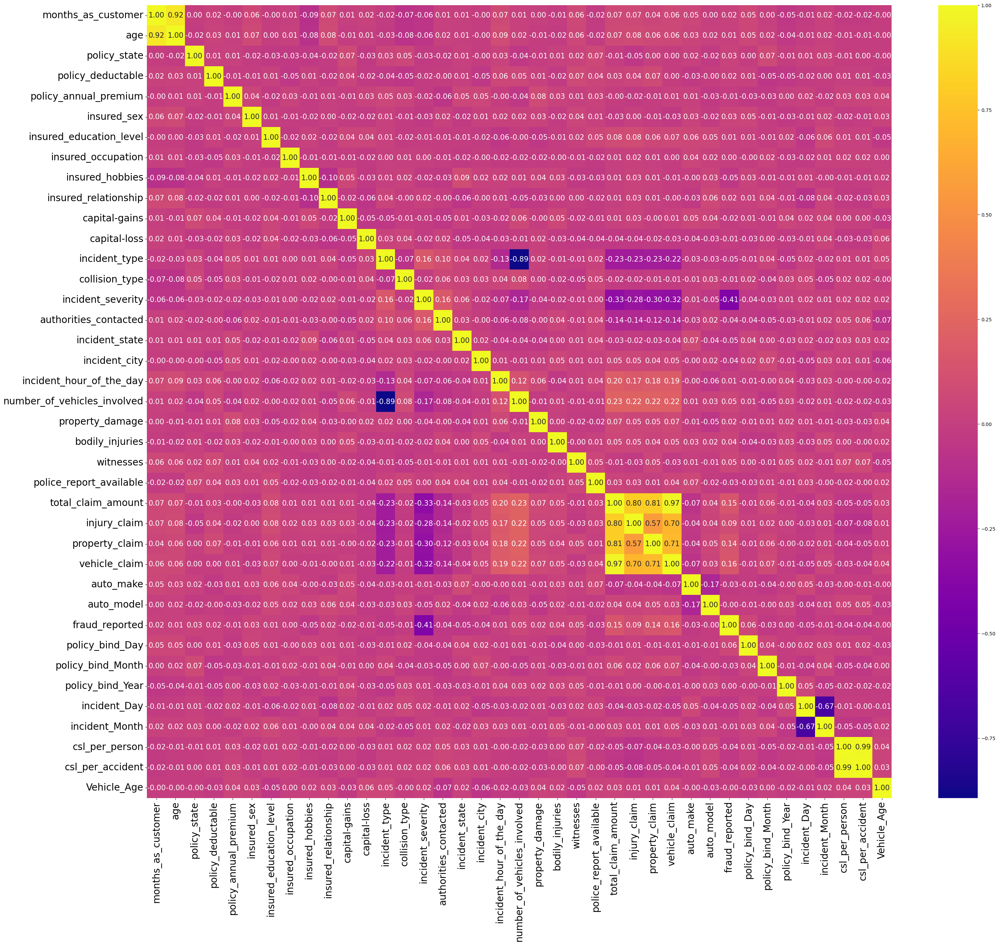

In [220]:
# Visualizing the correlation matrix by plotting heat map.
plt.figure(figsize=(35,30))
sns.heatmap(new_data.corr(),annot = True,fmt ='.2f', linecolor="black",annot_kws={'size':15},cmap="plasma")
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()

# Analysis of Correlation with Fraud_Report
We can see very less relationship with features and label

# Features correlation to each other causing multicollinearity problem
According to the heatmap below are the features depending on each other. 

Month_as_customer has 92% positive correlation with age 92%. This two features are depending on each other and this can cause multicollinearity problem

Total_claim_amount has 97% positive correlation with vehicle_claim 97%. Again this two features are depending on each other which can cause multicollinearity problem. 

Total_claim_amount has 81% positive correlation with property claim 81%. Again this two features are depending on each other which can cause multicollinearity issues. 

Total_claim_amount has 80% positive correlation with injury_claim 80. Again, this two features are depending on each other which can lead to multicollinearity problem. 

csl_per_person has 99% positive correlation with csl_per_accident. Again this two are depending on each other which can lead to multicollinearity issues. 

### Lets visualize their correlation using simply scatter plot

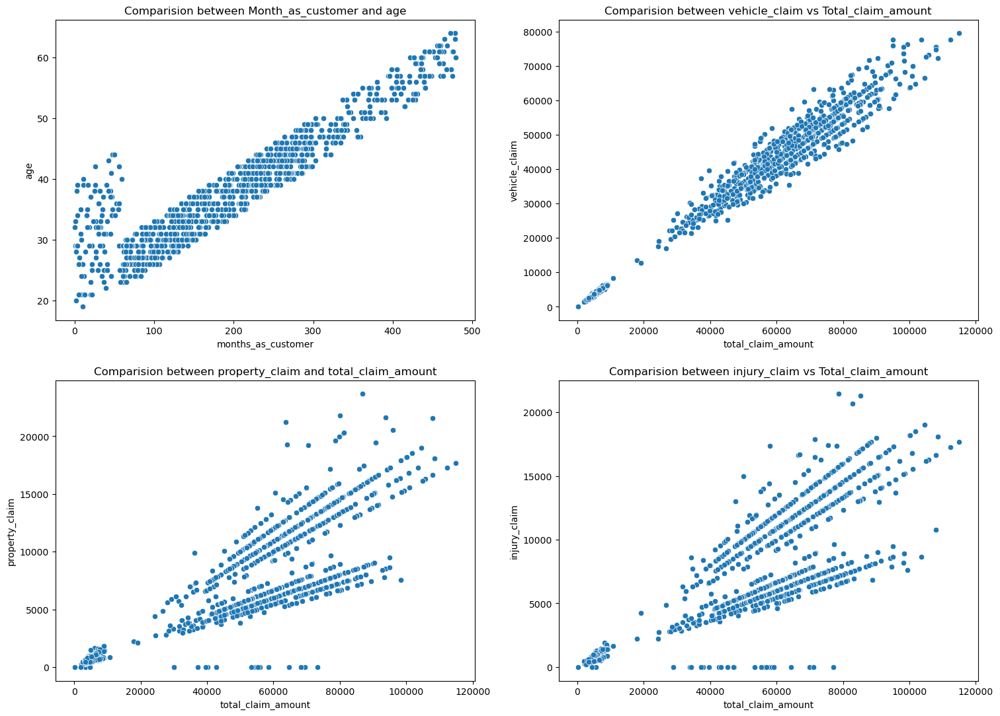

In [77]:
# Comparision between two variables
plt.figure(figsize=[18,13])

plt.subplot(2,2,1)
plt.title('Comparision between Month_as_customer and age')
sns.scatterplot(y='age',x='months_as_customer',data=data)
plt.xlabel('months_as_customer')
plt.ylabel('age');


plt.subplot(2,2,2)
plt.title('Comparision between vehicle_claim vs Total_claim_amount')
sns.scatterplot(y='vehicle_claim',x ='total_claim_amount',data=data)
plt.xlabel('total_claim_amount')
plt.ylabel('vehicle_claim');

plt.subplot(2,2,3)
plt.title('Comparision between property_claim and total_claim_amount')
sns.scatterplot(y='property_claim',x='total_claim_amount',data=data)
plt.xlabel('total_claim_amount')
plt.ylabel('property_claim');

plt.subplot(2,2,4)
plt.title('Comparision between injury_claim vs Total_claim_amount')
sns.scatterplot(y='injury_claim',x ='total_claim_amount',data=data)
plt.xlabel('total_claim_amount')
plt.ylabel('injury_claim');



Text(0, 0.5, 'csl_per_person')

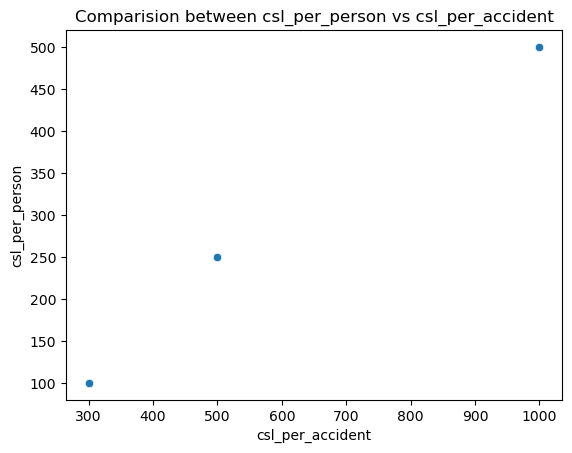

In [78]:
plt.figure()
plt.title('Comparision between csl_per_person vs csl_per_accident')
sns.scatterplot(y='csl_per_person',x ='csl_per_accident',data=data)
plt.xlabel('csl_per_accident')
plt.ylabel('csl_per_person')

The above scatter plots for each graph has given us clarity that those columns are depending on each other. That if one increases the other will increased as well, which can lead to multicollinearity issue. As we move forward I will be dropping total_claim_Amount simply because it has correlated with three featureas. property_claim. vehicle_claim and injury_claim. Again will drop csl_per_accident.  

In [79]:
new_data.drop(columns=['total_claim_amount','csl_per_accident'],axis=1, inplace=True)

In [80]:
new_data.shape

(996, 37)

Previously we having 39 columns, after dropping those above two features 'total_claim_amount' and 'csl_per_accident' we have 37 columns 

# Splitting the dataset into Features and Target

In [81]:
x = new_data.drop("fraud_reported", axis=1)
y = new_data["fraud_reported"]

In [82]:
print(len(x),len(y))

996 996


The length are same. 

## Feature Scaling using Standard Scaler

In [83]:
scaler = StandardScaler()
x_scaler = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x_scaler.head()

,months_as_customer,age,policy_state,policy_deductable,policy_annual_premium,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,...,vehicle_claim,auto_make,auto_model,policy_bind_Day,policy_bind_Month,policy_bind_Year,incident_Day,incident_Month,csl_per_person,Vehicle_Age
0,1.074671,0.987190,1.186130,-0.224722,0.621371,1.075102,0.531088,-1.162296,1.280299,-1.436113,...,0.754553,0.857248,-1.644810,0.177487,1.013751,1.686176,1.139807,-1.101370,-0.137684,0.182338
1,0.204846,0.330455,-0.018137,1.409024,-0.251375,1.075102,0.531088,-0.166257,0.928186,-0.246617,...,-1.787353,0.360986,-0.657437,1.309223,-0.166145,0.599693,0.756374,-1.101370,-0.137684,-0.316587
2,-0.612790,-1.092470,1.186130,1.409024,0.647301,-0.930144,1.557206,1.078792,-1.360550,0.348131,...,-0.820820,-0.631538,0.958263,-0.727901,-0.166145,-0.215170,0.852233,-0.026479,-1.066352,-0.316587
3,0.448397,0.221000,-1.222403,1.409024,0.658123,-0.930144,1.557206,-1.411305,-1.360550,0.942878,...,0.678427,-0.879669,1.317308,1.082875,-0.461119,-1.573274,-1.160788,1.553647,-0.137684,-1.480744
4,0.204846,0.549367,-1.222403,-0.224722,1.358059,1.075102,-1.521148,1.078792,-1.360550,0.942878,...,-1.740710,-1.624063,1.048024,-1.067422,-0.166145,1.686176,0.372942,-0.026479,1.410096,-0.649203


The data has now been scaled.

# Checking Multicollinearity

In [84]:
# Finding varience inflation factor in each scaled column
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['VIF'] = [variance_inflation_factor(x_scaler, i) for
              i in range (x_scaler.shape[1])]
vif['features'] = x.columns 
print(vif)

         VIF                     features
0   6.847077           months_as_customer
1   6.852905                          age
2   1.038072                 policy_state
3   1.043977            policy_deductable
4   1.036330        policy_annual_premium
5   1.029258                  insured_sex
6   1.046990      insured_education_level
7   1.016674           insured_occupation
8   1.049392              insured_hobbies
9   1.048658         insured_relationship
10  1.040356                capital-gains
11  1.042211                 capital-loss
12  5.138442                incident_type
13  1.047212               collision_type
14  1.195551            incident_severity
15  1.084547        authorities_contacted
16  1.040581               incident_state
17  1.029318                incident_city
18  1.096675     incident_hour_of_the_day
19  5.110588  number_of_vehicles_involved
20  1.030105              property_damage
21  1.026183              bodily_injuries
22  1.043608                    wi

 All the VIF values are less than 10 in all the columns. No features is facing multicollinearity issue. 

### Using Counter module mothod

In [85]:
# Counter module to count each class in target variable 
from collections import Counter
Counter(y)

Counter({1: 246, 0: 750})

The 0 class in our target column is more that 1 class which make the target imbalance, since it is classification problem we will need balance the data using oversampling method.

# SMOTE

In [86]:
# importing over smapling 
from imblearn.over_sampling import SMOTE
oversample = SMOTE()
x, y1 = oversample.fit_resample(x, y)
print("The number of classes before fit {}".format(Counter(y)))
print("The number of Classes after fit {}".format(Counter(y1)))

The number of classes before fit Counter({0: 750, 1: 246})
The number of Classes after fit Counter({1: 750, 0: 750})


In [87]:
Counter(y1)

Counter({1: 750, 0: 750})

Now our data is balanced, so we can build our models.

# Machine Learning

### Finding best random state

In [88]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.model_selection import train_test_split
rf = RandomForestClassifier()

In [89]:
maxAccu=0
maxRS=0

for i in range(1,200):
    x_train,x_test,y_train,y_test = train_test_split(x,y1,test_size=0.20, random_state =i)
    rf.fit(x_train, y_train)
    pred = rf.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is ",maxAccu," on Random_state ",maxRS)

Best accuracy is  0.92  on Random_state  10


We have got the best random state as 92 for test size 0.20.

## Creating train_test split

In [90]:
# Importing required libraries
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import AdaBoostClassifier,BaggingClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

In [91]:
# creating a function to run all the classifiers

def classifier(model, x, y1):
    x_train,x_test,y_train,y_test = train_test_split(x, y1, test_size=0.20, random_state=10)
    
    # Training the model
    model.fit(x_train, y_train)
    
    # Predicting y_test
    pred = model.predict(x_test)
    
    # Accuracy Score
    acc_score = (accuracy_score(y_test, pred))*100
    print("Accuracy Score:", acc_score)
    
    # Classification Report
    class_report = classification_report(y_test, pred)
    print("\nClassification Report:\n", class_report)
    
    # Cross Validation Score
    cv_score = (cross_val_score(model, x, y1, cv=5).mean())*100
    print("Cross Validation Score:", cv_score)
    
    # Result of accuracy minus cv scores
    result = acc_score - cv_score
    print("\nAccuracy Score - Cross Validation Score is", result)

### Logistic Regression

In [92]:
model = LogisticRegression()
classifier(model, x, y1)

Accuracy Score: 54.333333333333336

Classification Report:
               precision    recall  f1-score   support

           0       0.56      0.48      0.52       154
           1       0.53      0.61      0.57       146

    accuracy                           0.54       300
   macro avg       0.55      0.55      0.54       300
weighted avg       0.55      0.54      0.54       300

Cross Validation Score: 55.06666666666666

Accuracy Score - Cross Validation Score is -0.7333333333333272


### SVC Classifier

In [93]:
model = SVC()
classifier(model, x, y1)

Accuracy Score: 52.33333333333333

Classification Report:
               precision    recall  f1-score   support

           0       0.54      0.51      0.52       154
           1       0.51      0.54      0.52       146

    accuracy                           0.52       300
   macro avg       0.52      0.52      0.52       300
weighted avg       0.52      0.52      0.52       300

Cross Validation Score: 57.333333333333336

Accuracy Score - Cross Validation Score is -5.000000000000007


### Decision Tree Classifier

In [94]:
model = DecisionTreeClassifier()
classifier(model, x, y1)

Accuracy Score: 79.66666666666666

Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.78      0.80       154
           1       0.78      0.82      0.80       146

    accuracy                           0.80       300
   macro avg       0.80      0.80      0.80       300
weighted avg       0.80      0.80      0.80       300

Cross Validation Score: 83.46666666666665

Accuracy Score - Cross Validation Score is -3.799999999999997


### KNeighbors Classifier

In [95]:
model = KNeighborsClassifier()
classifier(model, x, y1)

Accuracy Score: 68.33333333333333

Classification Report:
               precision    recall  f1-score   support

           0       0.77      0.55      0.64       154
           1       0.63      0.82      0.72       146

    accuracy                           0.68       300
   macro avg       0.70      0.69      0.68       300
weighted avg       0.70      0.68      0.68       300

Cross Validation Score: 70.39999999999999

Accuracy Score - Cross Validation Score is -2.066666666666663


### Random Forest Classifier

In [96]:
model = RandomForestClassifier()
classifier(model, x, y1)

Accuracy Score: 91.33333333333333

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.89      0.91       154
           1       0.89      0.94      0.91       146

    accuracy                           0.91       300
   macro avg       0.91      0.91      0.91       300
weighted avg       0.91      0.91      0.91       300

Cross Validation Score: 85.73333333333333

Accuracy Score - Cross Validation Score is 5.599999999999994


### ExtraTrees Classifier

In [97]:
model = ExtraTreesClassifier()
classifier(model, x, y1)

Accuracy Score: 90.33333333333333

Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.90      0.90       154
           1       0.89      0.91      0.90       146

    accuracy                           0.90       300
   macro avg       0.90      0.90      0.90       300
weighted avg       0.90      0.90      0.90       300

Cross Validation Score: 86.66666666666666

Accuracy Score - Cross Validation Score is 3.6666666666666714


### AdaBoost Classifier

In [98]:
model = AdaBoostClassifier()
classifier(model, x, y1)

Accuracy Score: 86.66666666666667

Classification Report:
               precision    recall  f1-score   support

           0       0.86      0.89      0.87       154
           1       0.88      0.84      0.86       146

    accuracy                           0.87       300
   macro avg       0.87      0.87      0.87       300
weighted avg       0.87      0.87      0.87       300

Cross Validation Score: 84.2

Accuracy Score - Cross Validation Score is 2.4666666666666686


### Gradient Boosting Classifier

In [99]:
model = GradientBoostingClassifier()
classifier(model, x, y1)

Accuracy Score: 88.33333333333333

Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.88      0.89       154
           1       0.87      0.89      0.88       146

    accuracy                           0.88       300
   macro avg       0.88      0.88      0.88       300
weighted avg       0.88      0.88      0.88       300

Cross Validation Score: 85.46666666666667

Accuracy Score - Cross Validation Score is 2.86666666666666


### BaggingClassifier

In [100]:
model = BaggingClassifier()
classifier(model,x,y1)

Accuracy Score: 88.0

Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.88      0.88       154
           1       0.88      0.88      0.88       146

    accuracy                           0.88       300
   macro avg       0.88      0.88      0.88       300
weighted avg       0.88      0.88      0.88       300

Cross Validation Score: 86.06666666666666

Accuracy Score - Cross Validation Score is 1.9333333333333371


Comparing all the above models,  ExtraTreesClassifier gives the best results since the Accuracy Score - Cross Validation Score is the least along with higher Cross Validation Score and the second highest Accuracy Score comparing all the models.

# Hyper parameter tuning

In [101]:
x_train,x_test,y_train,y_test = train_test_split(x,y1,test_size=.20,random_state=41)

### Tuning ExtraTreesClassifier

In [103]:
# Initializing parameters list to pass into GridSearchCV

params = {'criterion' : ['gini', 'entropy'],
              'max_features' : ['auto', 'sqrt', 'log2'],
              'n_jobs' : [-2, -1, 1],
              'random_state' : [None, 80],
              'n_estimators': [100, 200, 300]}


In [105]:
gridcv = GridSearchCV(ExtraTreesClassifier(), params, cv=5)
gridcv.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [100, 200, 300], 'n_jobs': [-2, -1, 1],
                         'random_state': [None, 80]})

In [106]:
gridcv.best_params_

{'criterion': 'gini',
 'max_features': 'log2',
 'n_estimators': 200,
 'n_jobs': 1,
 'random_state': None}

These are the best parameters I will use to train the model

In [107]:
best_model = ExtraTreesClassifier(criterion = 'gini', max_features = 'log2', n_estimators = 200, n_jobs = 1 , random_state = None)   # best model with best parameters
best_train_fit= best_model.fit(x_train,y_train) # Final train  fit 
best_test_fit=best_model.fit(x_test, y_test)# final test fit 
best_pred = best_model.predict(x_test) # predicting with our model


print ("The Accuracy is: ", accuracy_score(y_test, best_pred)*100)
print ("The CV score is: ",(cross_val_score(best_model, x, y1, cv=5).mean())*100) 
print("The Confusion Matrix is: \n", confusion_matrix(y_test, best_pred))
print ('\n')
print("Classification Report: \n", classification_report(y_test, best_pred))
print ("="*65)
print('\n')

The Accuracy is:  100.0
The CV score is:  86.0
The Confusion Matrix is: 
 [[161   0]
 [  0 139]]


Classification Report: 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       161
           1       1.00      1.00      1.00       139

    accuracy                           1.00       300
   macro avg       1.00      1.00      1.00       300
weighted avg       1.00      1.00      1.00       300





After tunning the best model , there was an increase in accuracy score from 91% to 100%, why our cross validation score remain same. 

# AUC ROC curve

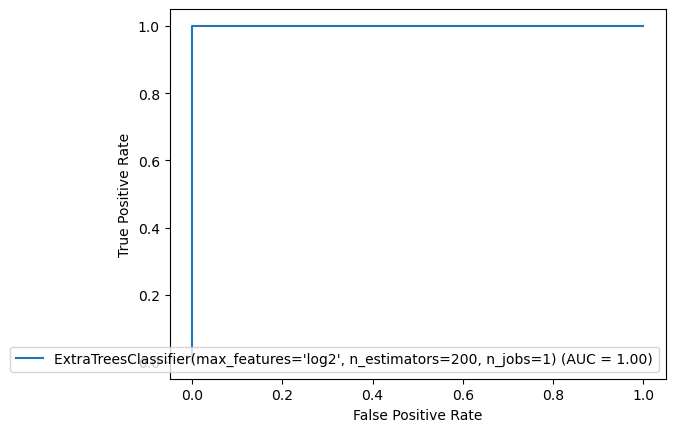

In [108]:
from sklearn import metrics
fpr, tpr, thresholds = metrics.roc_curve(y_test, best_pred)
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc = roc_auc, estimator_name = best_model)
display.plot()

We got final accuracy score of 100% and Cross Validation Score of 86.3% and also AUC score is 100% which is really good.

# Saving the model in pickle Format

In [109]:
import pickle
filename = 'Insurance_Claims_Fraud_Detection_Project_Best_Model.pkl'
pickle.dump(best_model, open(filename, 'wb'))

# Prediction with saved best_model

In [114]:
import numpy as np
actual=np.array(y_test)
predicted=np.array(best_model.predict(x_test))
df = pd.DataFrame({"Actual":actual,"Predicted":predicted},index= range(len(actual)))
df

,Actual,Predicted
0,1,1
1,1,1
2,1,1
3,0,0
4,1,1
...,...,...
295,1,1
296,0,0
297,0,0
298,1,1
